### Path and Import

In [1]:
import pandas as pd
import numpy as np
import math
import altair as alt
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

alt.data_transformers.disable_max_rows()

from sklearn.cluster import KMeans, Birch
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_samples, silhouette_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, mean_squared_error
from sklearn.metrics.pairwise import rbf_kernel

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from scikeras.wrappers import KerasRegressor

In [2]:
train_path = "https://raw.githubusercontent.com/lurrg/RSM8413-Assignment-Datasets/main/CensusCanada2021Training.csv"
test_path = "https://raw.githubusercontent.com/lurrg/RSM8413-Assignment-Datasets/main/CensusCanada2021Test.csv"

train_raw = pd.read_csv(train_path)
test_raw = pd.read_csv(test_path)

In [3]:
train_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5371 entries, 0 to 5370
Data columns (total 18 columns):
 #   Column                                                                     Non-Null Count  Dtype  
---  ------                                                                     --------------  -----  
 0   Total Population                                                           5371 non-null   int64  
 1   Total Households                                                           5297 non-null   float64
 2   Median Household Income (Current Year $)                                   5245 non-null   float64
 3   Total Households For Period Of Construction                                5297 non-null   float64
 4   Total Households For Period Of Construction Built Before 1961              5297 non-null   float64
 5   Total Households For Period Of Construction Built Between 1961 And 1980    5297 non-null   float64
 6   Total Households For Period Of Construction Built Betwee

In [4]:
test_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855 entries, 0 to 854
Data columns (total 17 columns):
 #   Column                                                                     Non-Null Count  Dtype
---  ------                                                                     --------------  -----
 0   Total Population                                                           855 non-null    int64
 1   Total Households                                                           855 non-null    int64
 2   Total Households For Period Of Construction                                855 non-null    int64
 3   Total Households For Period Of Construction Built Before 1961              855 non-null    int64
 4   Total Households For Period Of Construction Built Between 1961 And 1980    855 non-null    int64
 5   Total Households For Period Of Construction Built Between 1981 And 1990    855 non-null    int64
 6   Total Households For Period Of Construction Built Between 1991 And 2000   

In [5]:
train_cleaned = train_raw.dropna(subset=["Median Household Income (Current Year $)"])
train_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5245 entries, 0 to 5370
Data columns (total 18 columns):
 #   Column                                                                     Non-Null Count  Dtype  
---  ------                                                                     --------------  -----  
 0   Total Population                                                           5245 non-null   int64  
 1   Total Households                                                           5245 non-null   float64
 2   Median Household Income (Current Year $)                                   5245 non-null   float64
 3   Total Households For Period Of Construction                                5245 non-null   float64
 4   Total Households For Period Of Construction Built Before 1961              5245 non-null   float64
 5   Total Households For Period Of Construction Built Between 1961 And 1980    5245 non-null   float64
 6   Total Households For Period Of Construction Built Between 198

### EDA and Data Processing

In [6]:
corr_matrix = train_cleaned.corr()

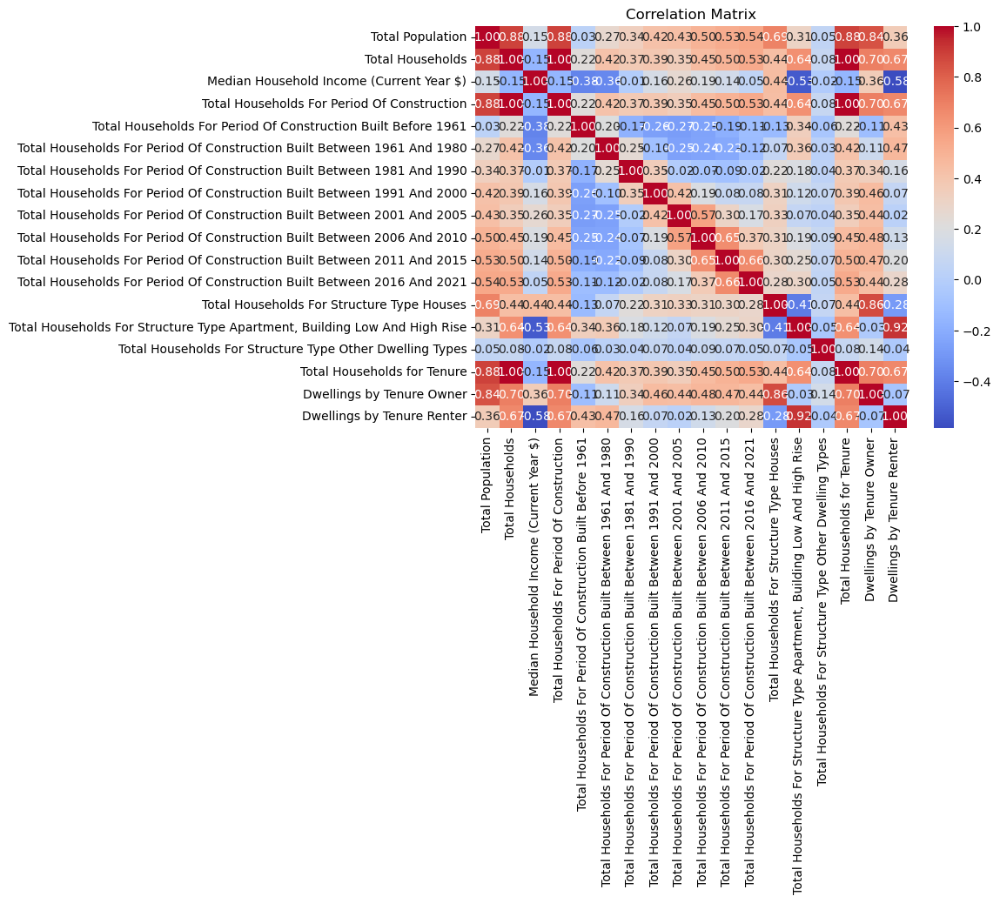

In [7]:
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

The correlation matrix shows that the median household income has higher correlation with below attributes:
- "households built before 1961": -0.38
- "households built between 1961 and 1980": -0.36
- "house type households": +0.44
- "apartment, building low/high rise type households": -0.53
- "dwellings by tenure owner": +0.36
- "dwellings by tenure renter": -0.58

From this part we can roughly see the trends:
- a CT with older households tends to have lower median income
- a CT with more apartment and building low/high rise type households tends to have lower median income
- a CT with many renters tends to have lower median income
- a CT with more house type households tends to have higher median income
- a CT with more owner dwellings tends to have higher median imcome

The scatter plots below basically show the same trends.


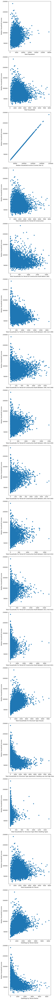

In [8]:
num_columns = len(train_cleaned.columns)

fig, axs = plt.subplots(nrows=num_columns, ncols=1, figsize=(6, 6 * num_columns))

for i, col in enumerate(train_cleaned.columns):
  axs[i].scatter(train_cleaned[col], train_cleaned["Median Household Income (Current Year $)"])
  axs[i].set_xlabel(col)
  axs[i].set_ylabel("Median Household Income")

plt.tight_layout()
plt.show()

I will select the attributes with higher correltions for analysis.

And since the coefficient for households built before 1961 and between 1961 and 1980 are similar, I will combine this two columns together to "before 1980".

In [9]:
train_selected = train_cleaned[["Total Households For Period Of Construction Built Before 1961",
                "Total Households For Period Of Construction Built Between 1961 And 1980",
                "Total Households For Structure Type Houses",
                "Total Households For Structure Type Apartment, Building Low And High Rise",
                "Dwellings by Tenure Owner",
                "Dwellings by Tenure Renter",
                "Median Household Income (Current Year $)"]]
train_selected.columns = ["households_built_before_1961", "households_built_between_1961_1980", "house_type", "apt_building_type",
              "owner_dwelling", "renter_dwelling", "median_income"]

train_selected = (train_selected.assign(households_built_before_1980 = train_selected["households_built_before_1961"] + train_selected["households_built_between_1961_1980"])
                  .drop(columns=["households_built_before_1961", "households_built_between_1961_1980"]))

train_selected.head()

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980
0,1135,130,1055.0,180.0,107000.0,1155.0
1,1605,50,1365.0,300.0,111000.0,0.0
2,2375,400,2360.0,420.0,105000.0,255.0
3,1265,275,1375.0,400.0,65000.0,1310.0
4,1035,325,1250.0,140.0,101000.0,200.0


(array([  4.,  10.,  18.,  55., 116., 162., 276., 313., 305., 352., 409.,
        349., 393., 380., 317., 256., 289., 255., 239., 195., 150., 108.,
        102.,  53.,  32.,  27.,  18.,  11.,  14.,   6.,   5.,   2.,   4.,
          5.,   0.,   3.,   3.,   2.,   2.,   2.,   0.,   0.,   2.,   0.,
          0.,   0.,   0.,   0.,   0.,   1.]),
 array([ 23400.,  27732.,  32064.,  36396.,  40728.,  45060.,  49392.,
         53724.,  58056.,  62388.,  66720.,  71052.,  75384.,  79716.,
         84048.,  88380.,  92712.,  97044., 101376., 105708., 110040.,
        114372., 118704., 123036., 127368., 131700., 136032., 140364.,
        144696., 149028., 153360., 157692., 162024., 166356., 170688.,
        175020., 179352., 183684., 188016., 192348., 196680., 201012.,
        205344., 209676., 214008., 218340., 222672., 227004., 231336.,
        235668., 240000.]),
 <BarContainer object of 50 artists>)

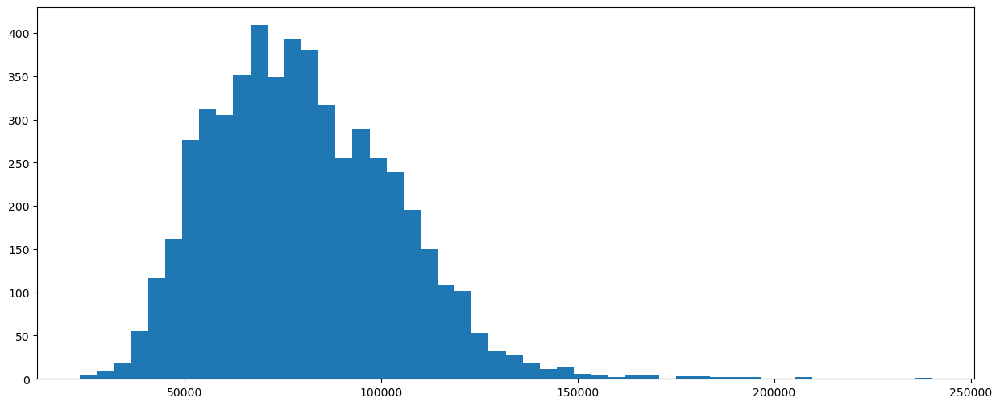

In [10]:
plt.figure(figsize=(15, 6))
plt.hist(train_selected["median_income"], bins=50)

In [11]:
fig = px.scatter_3d(train_selected, x="apt_building_type", y="renter_dwelling", z="households_built_before_1980", color="median_income")
fig.update_traces(marker=dict(size=5))
fig.show()

### Next scale the features.

In [12]:
scaler = MinMaxScaler()

In [13]:
train_scaled = pd.DataFrame(scaler.fit_transform(train_selected))
train_scaled.columns = train_selected.columns
train_scaled.head()

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980
0,0.158409,0.016603,0.173520,0.034026,0.385965,0.266744
1,0.224006,0.006386,0.224507,0.056711,0.404432,0.000000
2,0.331472,0.051086,0.388158,0.079395,0.376731,0.058891
3,0.176553,0.035121,0.226151,0.075614,0.192059,0.302540
4,0.144452,0.041507,0.205592,0.026465,0.358264,0.046189


### Clustering

In [14]:
# Silhouette score on scaled data
sh_scores_scaled = []
for k in range(2,31):
    kmeans = KMeans(n_clusters=k, n_init="auto")
    kmeans.fit(train_scaled)
    labels = kmeans.predict(train_scaled)
    sh_scores_scaled.append(silhouette_score(train_scaled, labels))
sh_scores_scaled

[0.3287075395430703,
 0.2434709068740146,
 0.2647551207150386,
 0.2592228953873876,
 0.23843118206601252,
 0.24417925339491303,
 0.24772690276582818,
 0.2331006673394151,
 0.2176890001273954,
 0.23942613074738053,
 0.231544884110016,
 0.22221524363008033,
 0.22395585113201363,
 0.21915854766781057,
 0.21677991348256495,
 0.2086552837688065,
 0.21669632561610355,
 0.214287974952872,
 0.21084064068407013,
 0.21323515163906503,
 0.21263186083921676,
 0.21545846571911512,
 0.20619459127253745,
 0.20731533206661462,
 0.19914475472307833,
 0.20008937867240628,
 0.19713751925861042,
 0.1985861169747603,
 0.1951338441286589]

In [15]:
## Silhouette score on unscaled data
# sh_scores_kmean = []
# for k in range(2,31):
#   kmeans = KMeans(n_clusters=k, n_init="auto")
#   kmeans.fit(train_selected)
#   labels = kmeans.predict(train_selected)
#   sh_scores_kmean.append(silhouette_score(train_selected, labels))
# sh_scores_kmean

In [16]:
## Silhouette score using Birch
# sh_scores_birch = []
# for k in range(2,31):
#   birch = Birch(n_clusters=k)
#   birch.fit(train_scaled)
#   labels = birch.predict(train_scaled)
#   sh_scores_birch.append(silhouette_score(train_scaled, labels))
# sh_scores_birch

### Using kmeans k=4.

In [17]:
k = 4
kmeans = KMeans(n_clusters=k, random_state=24)
kmeans.fit(train_scaled)

C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=4, random_state=24)

In [18]:
labels = kmeans.predict(train_scaled)
labels

array([3, 0, 0, ..., 2, 0, 1])

In [19]:
silhouette_score(train_scaled, labels)

0.2635228054991152

In [20]:
train_labeled = train_scaled.assign(labels=labels)
train_labeled.head()

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980,labels
0,0.158409,0.016603,0.173520,0.034026,0.385965,0.266744,3
1,0.224006,0.006386,0.224507,0.056711,0.404432,0.000000,0
2,0.331472,0.051086,0.388158,0.079395,0.376731,0.058891,0
3,0.176553,0.035121,0.226151,0.075614,0.192059,0.302540,3
4,0.144452,0.041507,0.205592,0.026465,0.358264,0.046189,0


In [21]:
fig_cluster = px.scatter_3d(train_labeled, x="apt_building_type", y="renter_dwelling", z="households_built_before_1980", color="labels")
fig_cluster.update_traces(marker=dict(size=3))
fig_cluster.show()

In [22]:
fig_income = px.scatter_3d(train_selected, x="apt_building_type", y="renter_dwelling", z="households_built_before_1980", color="median_income")
fig_income.update_traces(marker=dict(size=3))
fig_income.show()

(array([  1.,   4.,   6.,   9.,  18.,  34.,  56.,  75.,  94., 144., 147.,
        199., 199., 211., 222., 192., 232., 256., 224., 266., 235., 164.,
        228., 243., 203., 112., 177., 182., 126., 191., 135., 108.,  84.,
         90.,  84.,  45.,  57.,  39.,  22.,  24.,  12.,  18.,  10.,   8.,
         11.,   5.,   7.,   5.,   3.,   2.,   2.,   2.,   2.,   3.,   2.,
          0.,   1.,   5.,   0.,   1.,   1.,   2.,   0.,   2.,   0.,   0.,
          0.,   1.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   1.]),
 array([ 23400. ,  26107.5,  28815. ,  31522.5,  34230. ,  36937.5,
         39645. ,  42352.5,  45060. ,  47767.5,  50475. ,  53182.5,
         55890. ,  58597.5,  61305. ,  64012.5,  66720. ,  69427.5,
         72135. ,  74842.5,  77550. ,  80257.5,  82965. ,  85672.5,
         88380. ,  91087.5,  93795. ,  96502.5,  99210. , 101917.5,
        104625. , 107332.5, 110040. , 112747.5, 115455. , 118162.5,
        120870. , 123577.5, 126285. , 128992.5

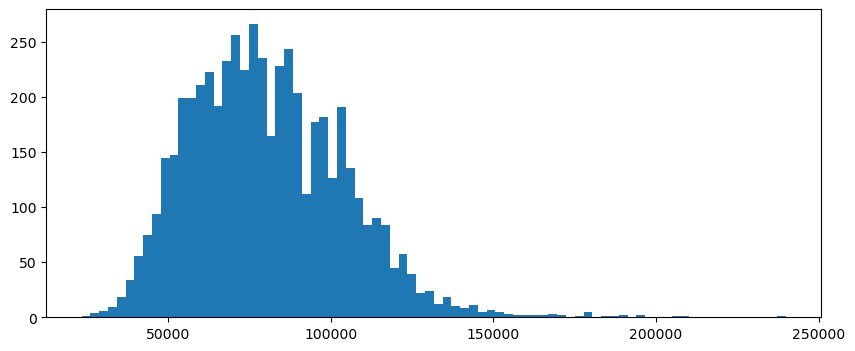

In [23]:
plt.figure(figsize=(10, 4))
plt.hist(train_selected["median_income"], bins=80)

In [24]:
centroids = kmeans.cluster_centers_
centroids_df = pd.DataFrame(centroids)
centroids_df.columns = train_scaled.columns
centroids_df

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980
0,0.183722,0.026855,0.214111,0.044671,0.374916,0.061207
1,0.072247,0.273512,0.159369,0.320135,0.158652,0.347737
2,0.084088,0.084169,0.115504,0.106859,0.200668,0.172292
3,0.249083,0.071860,0.292907,0.111591,0.273642,0.292443


In [25]:
max_income = max(train_selected["median_income"])
min_income = min(train_selected["median_income"])

In [26]:
label_col = [0,1,2,3]

label_income = pd.DataFrame({"label":label_col, "avg_median_income_scaled": centroids_df["median_income"]})
label_income = label_income.assign(avg_median_income = label_income["avg_median_income_scaled"]*(max_income-min_income)+min_income)
label_income

,label,avg_median_income_scaled,avg_median_income
0,0,0.374916,104606.757595
1,1,0.158652,57764.125561
2,2,0.200668,66864.631043
3,3,0.273642,82670.890411


### Evaluate clustering accuracy on income using MSE

In [27]:
# train_full = train_labeled.merge(label_income, left_on="labels", right_on="label", how="outer").drop(columns=["label"])
# train_full.head()

In [28]:
# print(train_full.shape)
# train_full["labels"].value_counts()

In [29]:
# train_evaluate = train_full.assign(income_sq_error=(train_full["median_income"]-train_full["avg_median_income_scaled"])**2)
# train_evaluate

In [30]:
# # Calculate median income MSE
# mse_scaled = math.sqrt(train_evaluate["income_sq_error"].sum())/len(train_evaluate)
# mse_scaled

In [31]:
# mse_scaled*(max_income-min_income)

In [32]:
train_wt_predincome = train_selected.assign(labels=labels).merge(label_income, left_on="labels", right_on="label", how="outer").drop(columns=["label"])
train_wt_predincome

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980,labels,avg_median_income_scaled,avg_median_income
0,1135,130,1055.0,180.0,107000.0,1155.0,3,0.273642,82670.890411
1,1265,275,1375.0,400.0,65000.0,1310.0,3,0.273642,82670.890411
2,1715,140,1660.0,220.0,96000.0,1105.0,3,0.273642,82670.890411
3,1350,130,1355.0,140.0,75000.0,1160.0,3,0.273642,82670.890411
4,1295,720,1315.0,680.0,81000.0,1405.0,3,0.273642,82670.890411
...,...,...,...,...,...,...,...,...,...
5240,600,995,715.0,905.0,59600.0,1290.0,2,0.200668,66864.631043
5241,810,1000,940.0,890.0,62800.0,150.0,2,0.200668,66864.631043
5242,120,5,100.0,50.0,88000.0,95.0,2,0.200668,66864.631043
5243,1270,95,965.0,395.0,75500.0,1005.0,2,0.200668,66864.631043


In [33]:
train_evaluate = train_wt_predincome.assign(income_sq_error=(train_wt_predincome["median_income"]-train_wt_predincome["avg_median_income"])**2)
train_evaluate

,house_type,apt_building_type,owner_dwelling,renter_dwelling,median_income,households_built_before_1980,labels,avg_median_income_scaled,avg_median_income,income_sq_error
0,1135,130,1055.0,180.0,107000.0,1155.0,3,0.273642,82670.890411,5.919056e+08
1,1265,275,1375.0,400.0,65000.0,1310.0,3,0.273642,82670.890411,3.122604e+08
2,1715,140,1660.0,220.0,96000.0,1105.0,3,0.273642,82670.890411,1.776652e+08
3,1350,130,1355.0,140.0,75000.0,1160.0,3,0.273642,82670.890411,5.884256e+07
4,1295,720,1315.0,680.0,81000.0,1405.0,3,0.273642,82670.890411,2.791875e+06
...,...,...,...,...,...,...,...,...,...,...
5240,600,995,715.0,905.0,59600.0,1290.0,2,0.200668,66864.631043,5.277486e+07
5241,810,1000,940.0,890.0,62800.0,150.0,2,0.200668,66864.631043,1.652123e+07
5242,120,5,100.0,50.0,88000.0,95.0,2,0.200668,66864.631043,4.467038e+08
5243,1270,95,965.0,395.0,75500.0,1005.0,2,0.200668,66864.631043,7.456960e+07


In [34]:
# Income MSE
math.sqrt(train_evaluate["income_sq_error"].sum()/len(train_evaluate))

15151.15422536561

### Separate clusters

In [35]:
train_org_labeled = train_cleaned.assign(labels=labels)
train_org_labeled

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,3088,1235.0,107000.0,1235.0,25.0,1130.0,50.0,15.0,10.0,10.0,0.0,0.0,1135,130,0,1235.0,1055.0,180.0,3
1,5889,1665.0,111000.0,1665.0,0.0,0.0,0.0,15.0,20.0,375.0,315.0,935.0,1605,50,10,1665.0,1365.0,300.0,0
2,8090,2775.0,105000.0,2775.0,105.0,150.0,240.0,1210.0,555.0,165.0,240.0,120.0,2375,400,0,2775.0,2360.0,420.0,0
3,4074,1775.0,65000.0,1775.0,210.0,1100.0,260.0,85.0,35.0,45.0,30.0,15.0,1265,275,235,1775.0,1375.0,400.0,3
4,3642,1385.0,101000.0,1385.0,10.0,190.0,1010.0,165.0,0.0,0.0,10.0,0.0,1035,325,25,1385.0,1250.0,140.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5366,3409,1460.0,84000.0,1460.0,15.0,0.0,0.0,0.0,20.0,40.0,465.0,915.0,780,675,5,1460.0,1060.0,400.0,0
5367,8408,4195.0,62800.0,4195.0,335.0,750.0,515.0,580.0,355.0,505.0,255.0,900.0,1505,2685,5,4195.0,1845.0,2350.0,1
5368,3609,1460.0,66000.0,1460.0,450.0,670.0,85.0,35.0,30.0,30.0,120.0,45.0,1220,275,0,1460.0,940.0,525.0,2
5369,3084,1165.0,100000.0,1165.0,70.0,365.0,280.0,180.0,105.0,80.0,50.0,40.0,815,335,15,1165.0,975.0,190.0,0


In [36]:
cluster0 = train_org_labeled[train_org_labeled["labels"] == 0]
cluster1 = train_org_labeled[train_org_labeled["labels"] == 1]
cluster2 = train_org_labeled[train_org_labeled["labels"] == 2]
cluster3 = train_org_labeled[train_org_labeled["labels"] == 3]

In [37]:
income_density = alt.Chart(train_org_labeled).transform_density(
    "Median Household Income (Current Year $)",
    groupby=["labels"],
    as_=["Median Household Income (Current Year $)", "density"]).mark_area(opacity=0.5).encode(
    x="Median Household Income (Current Year $):Q",
    y="density:Q",
    color="labels:N")
income_density

alt.Chart(...)

In [38]:
density_list = []
col_num = train_cleaned.shape[1]

for col in train_cleaned.columns.tolist():
    plot = alt.Chart(train_org_labeled).transform_density(
                        col,
                        groupby=["labels"],
                        as_=[col, "density"]).mark_area(opacity=0.5).encode(
                        x=col,
                        y="density:Q",
                        color="labels:N").properties(width=200, height=200)
    density_list.append(plot)

In [39]:
((density_list[0] | density_list[1] | density_list[2]) & (density_list[3] | density_list[4] | density_list[5])
 & (density_list[6] | density_list[7] | density_list[8]) & (density_list[9] | density_list[10] | density_list[11])
 & (density_list[12] | density_list[13] | density_list[14]) & (density_list[15] | density_list[16] | density_list[17]))

alt.VConcatChart(...)

We can find some features are relatively more separated between 4 clusters:


In [40]:
alt.Chart(cluster3).transform_density(
    "Total Households For Structure Type Apartment, Building Low And High Rise",
    as_=["Total Households For Structure Type Apartment, Building Low And High Rise", "density"]).mark_area().encode(
    x="Total Households For Structure Type Apartment, Building Low And High Rise:Q",
    y="density:Q")

alt.Chart(...)

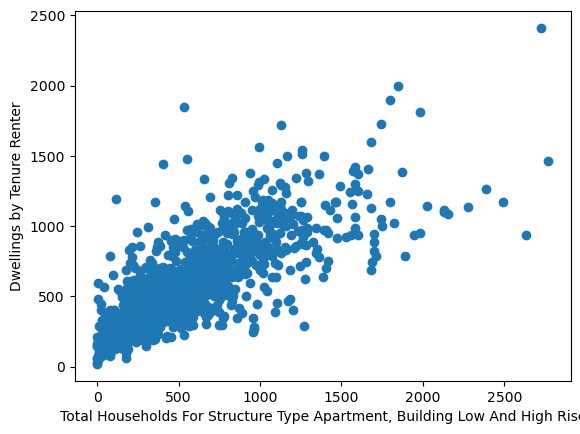

In [41]:
plt.scatter(cluster3["Total Households For Structure Type Apartment, Building Low And High Rise"], cluster3["Dwellings by Tenure Renter"])
plt.xlabel("Total Households For Structure Type Apartment, Building Low And High Rise")
plt.ylabel("Dwellings by Tenure Renter")
plt.show()

### Using clustered training dataset to build classification model - (Best: RandomForest)

In [42]:
X = train_labeled.drop(columns=["labels", "median_income"])
y = train_labeled["labels"]

In [43]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

In [44]:
X_train.head()

,house_type,apt_building_type,owner_dwelling,renter_dwelling,households_built_before_1980
1813,0.099791,0.184547,0.215461,0.161626,0.226328
1090,0.233077,0.095147,0.285362,0.126654,0.002309
2498,0.148639,0.209451,0.226151,0.263705,0.096998
2144,0.061410,0.079821,0.149671,0.029301,0.004619
2754,0.074669,0.345466,0.101151,0.511342,0.381062


In [45]:
y.value_counts()

labels
0    1619
2    1572
3    1163
1     891
Name: count, dtype: int64

In [46]:
y_train.value_counts()

labels
0    1299
2    1254
3     952
1     691
Name: count, dtype: int64

### Try Random Forest Classifier

In [47]:
rforest = RandomForestClassifier(random_state=42)

rforest_param_grid = {"max_depth": range(1, 100, 1),
            "n_estimators": range(1, 200, 1)}

In [48]:
rf_random_search = RandomizedSearchCV(rforest, rforest_param_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_random_search.fit(X_train, y_train)
best_rf_c = rf_random_search.best_estimator_

print("Random Forest best prediction on training set")
print(rf_random_search.best_params_)
print(rf_random_search.best_score_)
print(classification_report(y_train, best_rf_c.predict(X_train)))

Random Forest best prediction on training set
{'n_estimators': 135, 'max_depth': 85}
0.9177776831829275
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1299
           1       1.00      1.00      1.00       691
           2       1.00      1.00      1.00      1254
           3       1.00      1.00      1.00       952

    accuracy                           1.00      4196
   macro avg       1.00      1.00      1.00      4196
weighted avg       1.00      1.00      1.00      4196



In [49]:
test_predictions = best_rf_c.predict(X_test)

print("Random Forest best prediction on testing set")
print(best_rf_c.score(X_test, y_test))
print(classification_report(y_test, test_predictions))

Random Forest best prediction on testing set
0.9132507149666349
              precision    recall  f1-score   support

           0       0.89      0.89      0.89       320
           1       0.96      0.97      0.96       200
           2       0.90      0.89      0.90       318
           3       0.92      0.93      0.93       211

    accuracy                           0.91      1049
   macro avg       0.92      0.92      0.92      1049
weighted avg       0.91      0.91      0.91      1049



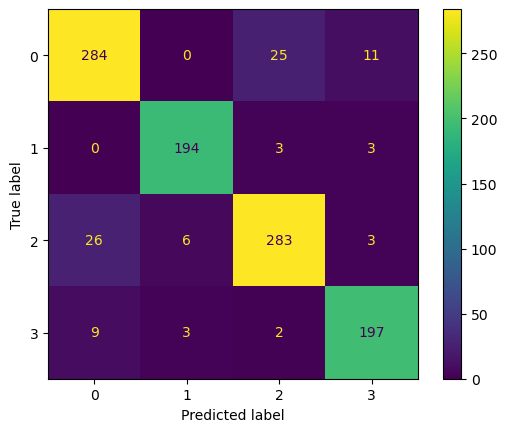

In [50]:
cm = confusion_matrix(y_test, test_predictions, labels=best_rf_c.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_rf_c.classes_)
disp.plot()
plt.show()

### Try KNN Classifier

In [51]:
knn = KNeighborsClassifier()
knn_param_grid = {"n_neighbors": range(1, 100, 1)}

In [52]:
knn_random_search = RandomizedSearchCV(knn, knn_param_grid, return_train_score=True, random_state=42, n_jobs=-1)
knn_random_search.fit(X_train, y_train)
best_knn_c = knn_random_search.best_estimator_

print("KNN best prediction on training set")
print(knn_random_search.best_params_)
print(knn_random_search.best_score_)
print(classification_report(y_train, best_knn_c.predict(X_train)))

KNN best prediction on training set
{'n_neighbors': 19}
0.9189718485725636
              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1299
           1       0.99      0.96      0.97       691
           2       0.90      0.92      0.91      1254
           3       0.94      0.94      0.94       952

    accuracy                           0.93      4196
   macro avg       0.93      0.93      0.93      4196
weighted avg       0.93      0.93      0.93      4196



In [53]:
test_pred_knn = best_knn_c.predict(X_test)

print("KNN best prediction on testing set")
print(best_knn_c.score(X_test, y_test))
print(classification_report(y_test, test_pred_knn))

KNN best prediction on testing set
0.9122974261201144
              precision    recall  f1-score   support

           0       0.88      0.88      0.88       320
           1       0.97      0.97      0.97       200
           2       0.90      0.89      0.89       318
           3       0.92      0.93      0.93       211

    accuracy                           0.91      1049
   macro avg       0.92      0.92      0.92      1049
weighted avg       0.91      0.91      0.91      1049



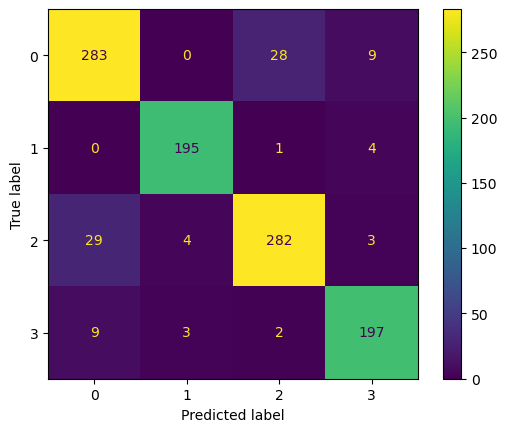

In [54]:
cm = confusion_matrix(y_test, test_pred_knn, labels=best_knn_c.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=best_knn_c.classes_)
disp.plot()
plt.show()

#### Random Forest Classifier (best_rf) got relatively better results

### Try regressions on whole training set - (Best: RandomForest)

In [55]:
scaler2 = MinMaxScaler()

train_org_scaled = pd.DataFrame(scaler2.fit_transform(train_org_labeled))
train_org_scaled.columns = train_org_labeled.columns
train_org_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.095977,0.147247,0.385965,0.147247,0.011682,0.357595,0.03003,0.006036,0.005348,0.004444,0.000000,0.000000,0.158409,0.016603,0.000000,0.147247,0.173520,0.034026,1.0
1,0.191239,0.202305,0.404432,0.202305,0.000000,0.000000,0.00000,0.006036,0.010695,0.166667,0.111111,0.166222,0.224006,0.006386,0.006006,0.202305,0.224507,0.056711,0.0


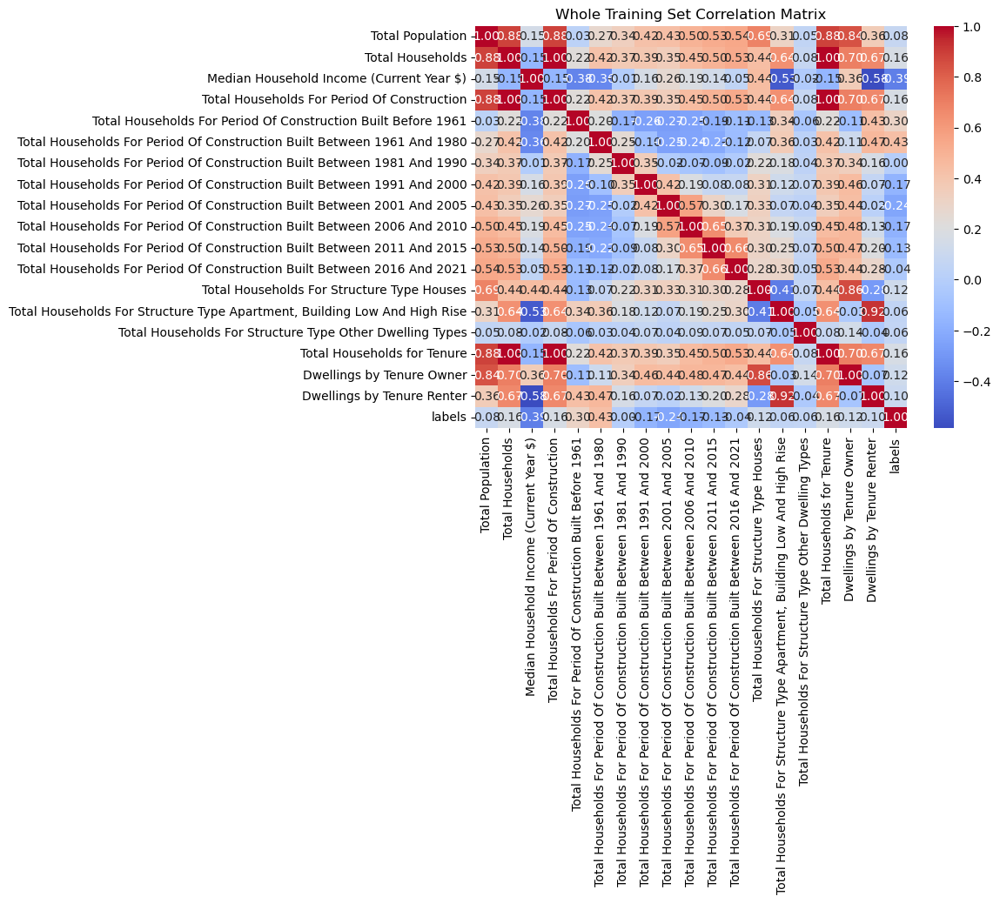

In [56]:
train_org_scaled_corrM = train_org_scaled.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(train_org_scaled_corrM, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Whole Training Set Correlation Matrix')
plt.show()

In [57]:
train_org_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.095977,0.147247,0.385965,0.147247,0.011682,0.357595,0.03003,0.006036,0.005348,0.004444,0.000000,0.000000,0.158409,0.016603,0.000000,0.147247,0.173520,0.034026,1.0
1,0.191239,0.202305,0.404432,0.202305,0.000000,0.000000,0.00000,0.006036,0.010695,0.166667,0.111111,0.166222,0.224006,0.006386,0.006006,0.202305,0.224507,0.056711,0.0


In [58]:
# # Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
# X_w = train_org_scaled.drop(columns=["Median Household Income (Current Year $)",
#                                       "Total Households For Period Of Construction Built Between 1981 And 1990",
#                                       "Total Households For Period Of Construction Built Between 2016 And 2021",
#                                       "Total Households For Structure Type Other Dwelling Types",
#                                       "Total Population",
#                                       "Total Households",
#                                       "Total Households For Period Of Construction",
#                                       "Total Households for Tenure",
#                                       "Total Households For Structure Type Apartment, Building Low And High Rise",
#                                       "Dwellings by Tenure Owner"])
# y_w = train_org_scaled["Median Household Income (Current Year $)"]

# X_w.head(2)

In [59]:
X_w = train_org_scaled.drop(columns=["Median Household Income (Current Year $)"])
y_w = train_org_scaled["Median Household Income (Current Year $)"]

X_w.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.095977,0.147247,0.147247,0.011682,0.357595,0.03003,0.006036,0.005348,0.004444,0.000000,0.000000,0.158409,0.016603,0.000000,0.147247,0.173520,0.034026,1.0
1,0.191239,0.202305,0.202305,0.000000,0.000000,0.00000,0.006036,0.010695,0.166667,0.111111,0.166222,0.224006,0.006386,0.006006,0.202305,0.224507,0.056711,0.0


In [60]:
X_w_train, X_w_test, y_w_train, y_w_test = train_test_split(X_w, y_w, test_size=0.2, random_state=42, shuffle=True)

#### Whole training set - Ridge Regression

In [61]:
ridge_w = Ridge(random_state=42)
ridge_w_grid = {"alpha": range(0, 100, 1)}

In [62]:
ridge_w_random_search = RandomizedSearchCV(ridge_w, ridge_w_grid, return_train_score=True, random_state=42, n_jobs=-1)
ridge_w_random_search.fit(X_w_train, y_w_train)
best_ridge_w = ridge_w_random_search.best_estimator_

print("Ridge Regression best prediction on training set")
print("Best Model: ", best_ridge_w)
print("Best Score: ", ridge_w_random_search.best_score_)
print("MSE: ", mean_squared_error(y_w_train, best_ridge_w.predict(X_w_train)))

Ridge Regression best prediction on training set
Best Model:  Ridge(alpha=0, random_state=42)
Best Score:  0.6085940871795066
MSE:  0.004532242948656469


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning:

Ill-conditioned matrix (rcond=3.63032e-17): result may not be accurate.



In [63]:
test_pred_ridge_w = best_ridge_w.predict(X_w_test)

print("Ridge Regression best prediction on testing set")
print("Best Score: ", best_ridge_w.score(X_w_test, y_w_test))
print("MSE: ", mean_squared_error(y_w_test, test_pred_ridge_w))

Ridge Regression best prediction on testing set
Best Score:  0.638394380045111
MSE:  0.004325385364021116


#### Whole training set - SVR

In [64]:
svr_w = SVR()
svr_w_grid = {"kernel": ["linear", "poly", "rbf", "sigmoid", "precomputed"],
              "degree": range(0, 100, 1),
              "gamma": ["scale", "auto"],
              "C": range(0, 100, 1),
              "epsilon": np.arange(0,20, 0.1)}

In [65]:
svr_w_random_search = RandomizedSearchCV(svr_w, svr_w_grid, return_train_score=True, random_state=42, n_jobs=-1)
svr_w_random_search.fit(rbf_kernel(X_w_train.values), y_w_train)
best_svr_w = svr_w_random_search.best_estimator_

print("SVR Regression best prediction on training set")
print("Best Model: ", best_svr_w)
print("Best Score: ", svr_w_random_search.best_score_)
print("MSE: ", mean_squared_error(y_w_train, best_svr_w.predict(rbf_kernel(X_w_train.values))))

SVR Regression best prediction on training set
Best Model:  SVR(C=66, degree=57, epsilon=10.9)
Best Score:  -4.346990395027013
MSE:  0.06741144232759587


#### *Whole training set - Random Forest Regression*

In [66]:
rf_w = RandomForestRegressor(random_state=42)
rf_w_grid = {"n_estimators": range(1, 500, 1),
              "max_depth": range(1, 100, 1),
              "min_samples_split": range(2, 100, 1)}

In [67]:
rf_w_random_search = RandomizedSearchCV(rf_w, rf_w_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_w_random_search.fit(X_w_train, y_w_train)
best_rf_w = rf_w_random_search.best_estimator_

print("Random Forest Regression best prediction on training set")
print("Best Model: ", best_rf_w)
print("Best Score: ", rf_w_random_search.best_score_)
print("MSE: ", mean_squared_error(y_w_train, best_rf_w.predict(X_w_train)))

Random Forest Regression best prediction on training set
Best Model:  RandomForestRegressor(max_depth=89, min_samples_split=4, n_estimators=199,
                      random_state=42)
Best Score:  0.7708221438442766
MSE:  0.0004366920896382615


In [68]:
test_pred_rf_w = best_rf_w.predict(X_w_test)

print("Random Forest Regression best prediction on testing set")
print("Best Score: ", best_rf_w.score(X_w_test, y_w_test))
print("MSE: ", mean_squared_error(y_w_test, test_pred_rf_w))

Random Forest Regression best prediction on testing set
Best Score:  0.8064966297549108
MSE:  0.0023146118294601788


#### Whole training set - ANN

In [69]:
def build_model():
    
    np.random.seed(42)
    tf.random.set_seed(42)
    
    model = Sequential()
    
    model.add(Dense(64, activation='relu', input_shape=[len(X_w_train.keys())]))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1))
    
    optimizer = tf.keras.optimizers.RMSprop(0.001)
    
    model.compile(loss="mse", optimizer=optimizer, metrics=["accuracy", "mae", "mse"])
    
    return model

In [70]:
ann_w = KerasRegressor(build_fn=build_model, verbose=2)
ann_w_grid = {"batch_size": range(1, 500, 10),
              "epochs": range(1, 100, 10)}

In [71]:
ann_w_random_search = RandomizedSearchCV(ann_w, ann_w_grid, cv=3, n_iter=5, verbose=2, n_jobs=-1, random_state=42)
ann_w_result = ann_w_random_search.fit(X_w_train, y_w_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



Epoch 1/61
42/42 - 1s - loss: 0.0115 - accuracy: 2.3832e-04 - mae: 0.0755 - mse: 0.0115 - 993ms/epoch - 24ms/step
Epoch 2/61
42/42 - 0s - loss: 0.0055 - accuracy: 2.3832e-04 - mae: 0.0538 - mse: 0.0055 - 73ms/epoch - 2ms/step
Epoch 3/61
42/42 - 0s - loss: 0.0045 - accuracy: 2.3832e-04 - mae: 0.0491 - mse: 0.0045 - 79ms/epoch - 2ms/step
Epoch 4/61
42/42 - 0s - loss: 0.0043 - accuracy: 2.3832e-04 - mae: 0.0479 - mse: 0.0043 - 77ms/epoch - 2ms/step
Epoch 5/61
42/42 - 0s - loss: 0.0040 - accuracy: 2.3832e-04 - mae: 0.0468 - mse: 0.0040 - 63ms/epoch - 1ms/step
Epoch 6/61
42/42 - 0s - loss: 0.0038 - accuracy: 2.3832e-04 - mae: 0.0453 - mse: 0.0038 - 73ms/epoch - 2ms/step
Epoch 7/61
42/42 - 0s - loss: 0.0038 - accuracy: 2.3832e-04 - mae: 0.0451 - mse: 0.0038 - 71ms/epoch - 2ms/step
Epoch 8/61
42/42 - 0s - loss: 0.0037 - accuracy: 2.3832e-04 - mae: 0.0447 - mse: 0.0037 - 70ms/epoch - 2ms/step
Epoch 9/61
42/42 - 0s - loss: 0.0035 - accuracy: 2.3832e-04 - mae: 0.0435 - mse: 0.0035 - 73ms/epoch -

In [72]:
print("ANN Regression best prediction on training set")
print("Best Parameter: ", ann_w_result.best_params_)
print("Best Score: ", ann_w_result.best_score_)

ANN Regression best prediction on training set
Best Parameter:  {'epochs': 61, 'batch_size': 101}
Best Score:  0.7603011138105421


In [73]:
np.random.seed(42)
tf.random.set_seed(42)

ann_w_test_result = ann_w.fit(X_w_test, y_w_test, epochs=61, batch_size=101)

Epoch 1/61


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



11/11 - 1s - loss: 0.0202 - accuracy: 0.0000e+00 - mae: 0.1044 - mse: 0.0202 - 849ms/epoch - 77ms/step
Epoch 2/61
11/11 - 0s - loss: 0.0084 - accuracy: 0.0000e+00 - mae: 0.0674 - mse: 0.0084 - 21ms/epoch - 2ms/step
Epoch 3/61
11/11 - 0s - loss: 0.0062 - accuracy: 0.0000e+00 - mae: 0.0573 - mse: 0.0062 - 24ms/epoch - 2ms/step
Epoch 4/61
11/11 - 0s - loss: 0.0055 - accuracy: 0.0000e+00 - mae: 0.0548 - mse: 0.0055 - 27ms/epoch - 2ms/step
Epoch 5/61
11/11 - 0s - loss: 0.0049 - accuracy: 0.0000e+00 - mae: 0.0521 - mse: 0.0049 - 22ms/epoch - 2ms/step
Epoch 6/61
11/11 - 0s - loss: 0.0048 - accuracy: 0.0000e+00 - mae: 0.0524 - mse: 0.0048 - 23ms/epoch - 2ms/step
Epoch 7/61
11/11 - 0s - loss: 0.0040 - accuracy: 0.0000e+00 - mae: 0.0474 - mse: 0.0040 - 23ms/epoch - 2ms/step
Epoch 8/61
11/11 - 0s - loss: 0.0043 - accuracy: 0.0000e+00 - mae: 0.0497 - mse: 0.0043 - 21ms/epoch - 2ms/step
Epoch 9/61
11/11 - 0s - loss: 0.0043 - accuracy: 0.0000e+00 - mae: 0.0498 - mse: 0.0043 - 24ms/epoch - 2ms/step
E

### Try regressions on cluster 0

In [74]:
scaler3 = MinMaxScaler()

cluster0_scaled = pd.DataFrame(scaler3.fit_transform(cluster0))
cluster0_scaled.columns = cluster0.columns
cluster0_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.374873,0.392547,0.286504,0.392547,0.000000,0.000000,0.000000,0.009174,0.014085,0.219298,0.176966,0.340000,0.393865,0.022222,0.01,0.392547,0.350068,0.179104,0.0
1,0.523379,0.668323,0.253319,0.668323,0.079545,0.147783,0.144144,0.740061,0.390845,0.096491,0.134831,0.043636,0.582822,0.177778,0.00,0.668323,0.620081,0.250746,0.0


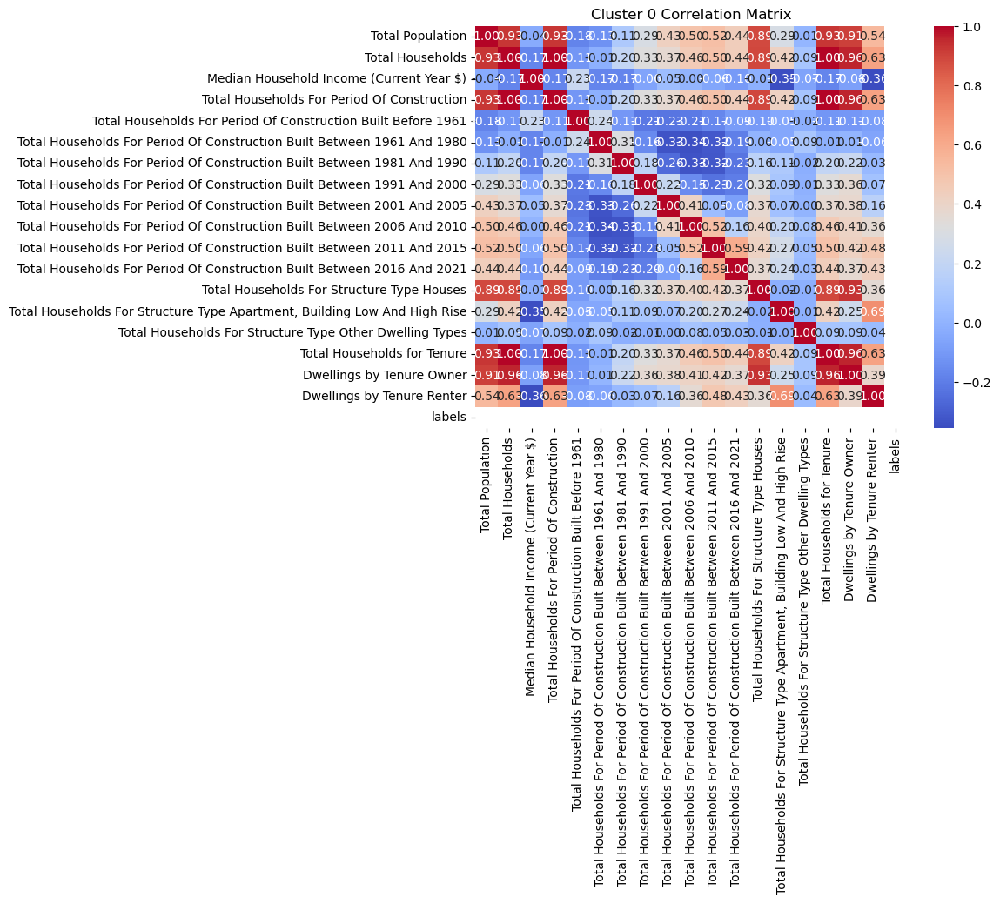

In [75]:
cluster0_corrM = cluster0_scaled.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(cluster0_corrM, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Cluster 0 Correlation Matrix')
plt.show()

In [76]:
cluster0_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.374873,0.392547,0.286504,0.392547,0.000000,0.000000,0.000000,0.009174,0.014085,0.219298,0.176966,0.340000,0.393865,0.022222,0.01,0.392547,0.350068,0.179104,0.0
1,0.523379,0.668323,0.253319,0.668323,0.079545,0.147783,0.144144,0.740061,0.390845,0.096491,0.134831,0.043636,0.582822,0.177778,0.00,0.668323,0.620081,0.250746,0.0


In [77]:
# # Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
# X_0 = cluster0_scaled.drop(columns=["Median Household Income (Current Year $)",
#                              "Total Population",
#                              "Total Households For Period Of Construction",
#                              "Total Households For Period Of Construction Built Between 1991 And 2000",
#                              "Total Households For Period Of Construction Built Between 2001 And 2005",
#                              "Total Households For Period Of Construction Built Between 2006 And 2010",
#                              "Total Households For Period Of Construction Built Between 2011 And 2015",
#                              "Total Households For Structure Type Houses",
#                              "Total Households For Structure Type Other Dwelling Types",
#                              "Total Households for Tenure",
#                              "Dwellings by Tenure Owner"])
# y_0 = cluster0_scaled["Median Household Income (Current Year $)"]

# X_0.head(2)

In [78]:
# Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
X_0 = cluster0_scaled.drop(columns=["Median Household Income (Current Year $)"])
y_0 = cluster0_scaled["Median Household Income (Current Year $)"]
X_0.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.374873,0.392547,0.392547,0.000000,0.000000,0.000000,0.009174,0.014085,0.219298,0.176966,0.340000,0.393865,0.022222,0.01,0.392547,0.350068,0.179104,0.0
1,0.523379,0.668323,0.668323,0.079545,0.147783,0.144144,0.740061,0.390845,0.096491,0.134831,0.043636,0.582822,0.177778,0.00,0.668323,0.620081,0.250746,0.0


In [79]:
X_0_train, X_0_test, y_0_train, y_0_test = train_test_split(X_0, y_0, test_size=0.2, random_state=42, shuffle=True)

#### Cluster 0 - Ridge Regression

In [80]:
ridge_0 = Ridge(random_state=42)
ridge_0_grid = {"alpha": range(0, 100, 1)}

In [81]:
ridge_0_random_search = RandomizedSearchCV(ridge_0, ridge_0_grid, return_train_score=True, random_state=42, n_jobs=-1)
ridge_0_random_search.fit(X_0_train, y_0_train)
best_ridge_0 = ridge_0_random_search.best_estimator_

print("Ridge Regression best prediction on training set")
print("Best Model: ", best_ridge_0)
print("Best Score: ", ridge_0_random_search.best_score_)
print("MSE: ", mean_squared_error(y_0_train, best_ridge_0.predict(X_0_train)))

Ridge Regression best prediction on training set
Best Model:  Ridge(alpha=0, random_state=42)
Best Score:  0.2615183154348875
MSE:  0.00728193407416857


In [82]:
test_pred_ridge_0 = best_ridge_0.predict(X_0_test)

print("Ridge Regression best prediction on testing set")
print("Best Score: ", best_ridge_0.score(X_0_test, y_0_test))
print("MSE: ", mean_squared_error(y_0_test, test_pred_ridge_0))

Ridge Regression best prediction on testing set
Best Score:  0.27453879839080964
MSE:  0.005932333893750911


#### Cluster 0 - SVR

In [83]:
svr_0 = SVR()
svr_0_grid = {"kernel": ["linear", "poly", "rbf", "sigmoid", "precomputed"],
              "degree": range(0, 100, 1),
              "gamma": ["scale", "auto"],
              "C": range(0, 100, 1),
              "epsilon": np.arange(0,20, 0.1)}

In [84]:
svr_0_random_search = RandomizedSearchCV(svr_0, svr_0_grid, return_train_score=True, random_state=42, n_jobs=-1)
svr_0_random_search.fit(rbf_kernel(X_0_train.values), y_0_train)
best_svr_0 = svr_0_random_search.best_estimator_

print("SVR Regression best prediction on training set")
print("Best Model: ", best_svr_0)
print("Best Score: ", svr_0_random_search.best_score_)
print("MSE: ", mean_squared_error(y_0_train, best_svr_0.predict(rbf_kernel(X_0_train.values))))

SVR Regression best prediction on training set
Best Model:  SVR(C=66, degree=57, epsilon=10.9)
Best Score:  -5.650086583692927
MSE:  0.07185484564262024


#### Cluster 0 - Random Forest Regression¶

In [85]:
rf_0 = RandomForestRegressor(random_state=42)
rf_0_grid = {"n_estimators": range(1, 500, 1),
              "max_depth": range(1, 100, 1),
              "min_samples_split": range(2, 100, 1)}

In [86]:
rf_0_random_search = RandomizedSearchCV(rf_0, rf_0_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_0_random_search.fit(X_0_train, y_0_train)
best_rf_0 = rf_0_random_search.best_estimator_

print("Random Forest Regression best prediction on training set")
print("Best Model: ", best_rf_0)
print("Best Score: ", rf_0_random_search.best_score_)
print("MSE: ", mean_squared_error(y_0_train, best_rf_0.predict(X_0_train)))

Random Forest Regression best prediction on training set
Best Model:  RandomForestRegressor(max_depth=89, min_samples_split=4, n_estimators=199,
                      random_state=42)
Best Score:  0.3851159418886112
MSE:  0.001084195348543425


In [87]:
test_pred_rf_0 = best_rf_0.predict(X_0_test)

print("Random Forest Regression best prediction on testing set")
print("Best Score: ", best_rf_0.score(X_0_test, y_0_test))
print("MSE: ", mean_squared_error(y_0_test, test_pred_rf_0))

Random Forest Regression best prediction on testing set
Best Score:  0.40104824560675933
MSE:  0.004897824701620239


#### Cluster 0 - ANN

In [88]:
ann_0 = KerasRegressor(build_fn=build_model, verbose=2)
ann_0_grid = {"batch_size": range(1, 500, 10),
              "epochs": range(1, 100, 10)}

In [89]:
ann_0_random_search = RandomizedSearchCV(ann_0, ann_0_grid, cv=3, n_iter=5, verbose=2, n_jobs=-1, random_state=42)
ann_0_result = ann_0_random_search.fit(X_0_train, y_0_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Epoch 1/81


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



4/4 - 1s - loss: 0.0444 - accuracy: 7.7220e-04 - mae: 0.1719 - mse: 0.0444 - 781ms/epoch - 195ms/step
Epoch 2/81
4/4 - 0s - loss: 0.0190 - accuracy: 7.7220e-04 - mae: 0.0999 - mse: 0.0190 - 11ms/epoch - 3ms/step
Epoch 3/81
4/4 - 0s - loss: 0.0164 - accuracy: 7.7220e-04 - mae: 0.0923 - mse: 0.0164 - 15ms/epoch - 4ms/step
Epoch 4/81
4/4 - 0s - loss: 0.0146 - accuracy: 7.7220e-04 - mae: 0.0864 - mse: 0.0146 - 13ms/epoch - 3ms/step
Epoch 5/81
4/4 - 0s - loss: 0.0128 - accuracy: 7.7220e-04 - mae: 0.0801 - mse: 0.0128 - 19ms/epoch - 5ms/step
Epoch 6/81
4/4 - 0s - loss: 0.0111 - accuracy: 7.7220e-04 - mae: 0.0744 - mse: 0.0111 - 16ms/epoch - 4ms/step
Epoch 7/81
4/4 - 0s - loss: 0.0097 - accuracy: 7.7220e-04 - mae: 0.0688 - mse: 0.0097 - 14ms/epoch - 4ms/step
Epoch 8/81
4/4 - 0s - loss: 0.0087 - accuracy: 7.7220e-04 - mae: 0.0641 - mse: 0.0087 - 14ms/epoch - 4ms/step
Epoch 9/81
4/4 - 0s - loss: 0.0091 - accuracy: 7.7220e-04 - mae: 0.0679 - mse: 0.0091 - 13ms/epoch - 3ms/step
Epoch 10/81
4/4 - 

Epoch 75/81
4/4 - 0s - loss: 0.0066 - accuracy: 7.7220e-04 - mae: 0.0580 - mse: 0.0066 - 14ms/epoch - 3ms/step
Epoch 76/81
4/4 - 0s - loss: 0.0064 - accuracy: 0.0015 - mae: 0.0575 - mse: 0.0064 - 16ms/epoch - 4ms/step
Epoch 77/81
4/4 - 0s - loss: 0.0060 - accuracy: 0.0015 - mae: 0.0542 - mse: 0.0060 - 14ms/epoch - 4ms/step
Epoch 78/81
4/4 - 0s - loss: 0.0064 - accuracy: 7.7220e-04 - mae: 0.0564 - mse: 0.0064 - 11ms/epoch - 3ms/step
Epoch 79/81
4/4 - 0s - loss: 0.0071 - accuracy: 7.7220e-04 - mae: 0.0604 - mse: 0.0071 - 15ms/epoch - 4ms/step
Epoch 80/81
4/4 - 0s - loss: 0.0063 - accuracy: 7.7220e-04 - mae: 0.0558 - mse: 0.0063 - 14ms/epoch - 4ms/step
Epoch 81/81
4/4 - 0s - loss: 0.0059 - accuracy: 7.7220e-04 - mae: 0.0532 - mse: 0.0059 - 13ms/epoch - 3ms/step


In [90]:
print("ANN Regression best prediction on training set")
print("Best Parameter: ", ann_0_result.best_params_)
print("Best Score: ", ann_0_result.best_score_)

ANN Regression best prediction on training set
Best Parameter:  {'epochs': 81, 'batch_size': 341}
Best Score:  0.3519973800928302


In [91]:
np.random.seed(42)
tf.random.set_seed(42)

ann_0_test_result = ann_0.fit(X_0_test, y_0_test, epochs=21, batch_size=101)

Epoch 1/21


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



4/4 - 1s - loss: 0.0198 - accuracy: 0.0000e+00 - mae: 0.1131 - mse: 0.0198 - 815ms/epoch - 204ms/step
Epoch 2/21
4/4 - 0s - loss: 0.0138 - accuracy: 0.0000e+00 - mae: 0.0920 - mse: 0.0138 - 12ms/epoch - 3ms/step
Epoch 3/21
4/4 - 0s - loss: 0.0117 - accuracy: 0.0000e+00 - mae: 0.0839 - mse: 0.0117 - 12ms/epoch - 3ms/step
Epoch 4/21
4/4 - 0s - loss: 0.0108 - accuracy: 0.0000e+00 - mae: 0.0809 - mse: 0.0108 - 11ms/epoch - 3ms/step
Epoch 5/21
4/4 - 0s - loss: 0.0093 - accuracy: 0.0000e+00 - mae: 0.0740 - mse: 0.0093 - 11ms/epoch - 3ms/step
Epoch 6/21
4/4 - 0s - loss: 0.0085 - accuracy: 0.0000e+00 - mae: 0.0690 - mse: 0.0085 - 12ms/epoch - 3ms/step
Epoch 7/21
4/4 - 0s - loss: 0.0078 - accuracy: 0.0000e+00 - mae: 0.0670 - mse: 0.0078 - 13ms/epoch - 3ms/step
Epoch 8/21
4/4 - 0s - loss: 0.0074 - accuracy: 0.0000e+00 - mae: 0.0644 - mse: 0.0074 - 11ms/epoch - 3ms/step
Epoch 9/21
4/4 - 0s - loss: 0.0066 - accuracy: 0.0000e+00 - mae: 0.0603 - mse: 0.0066 - 10ms/epoch - 2ms/step
Epoch 10/21
4/4 - 

### Try regressions on cluster 1

In [92]:
scaler4 = MinMaxScaler()

cluster1_scaled = pd.DataFrame(scaler4.fit_transform(cluster1))
cluster1_scaled.columns = cluster1.columns
cluster1_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.19747,0.066205,0.859375,0.066205,0.617188,0.071203,0.032154,0.040486,0.072193,0.013333,0.019400,0.011111,0.101796,0.099639,0.000000,0.066205,0.256637,0.061715,0.0
1,0.14174,0.079292,0.475000,0.079292,0.257812,0.246835,0.064309,0.064777,0.045455,0.026667,0.017637,0.064815,0.115768,0.103249,0.013158,0.079292,0.190898,0.132845,0.0


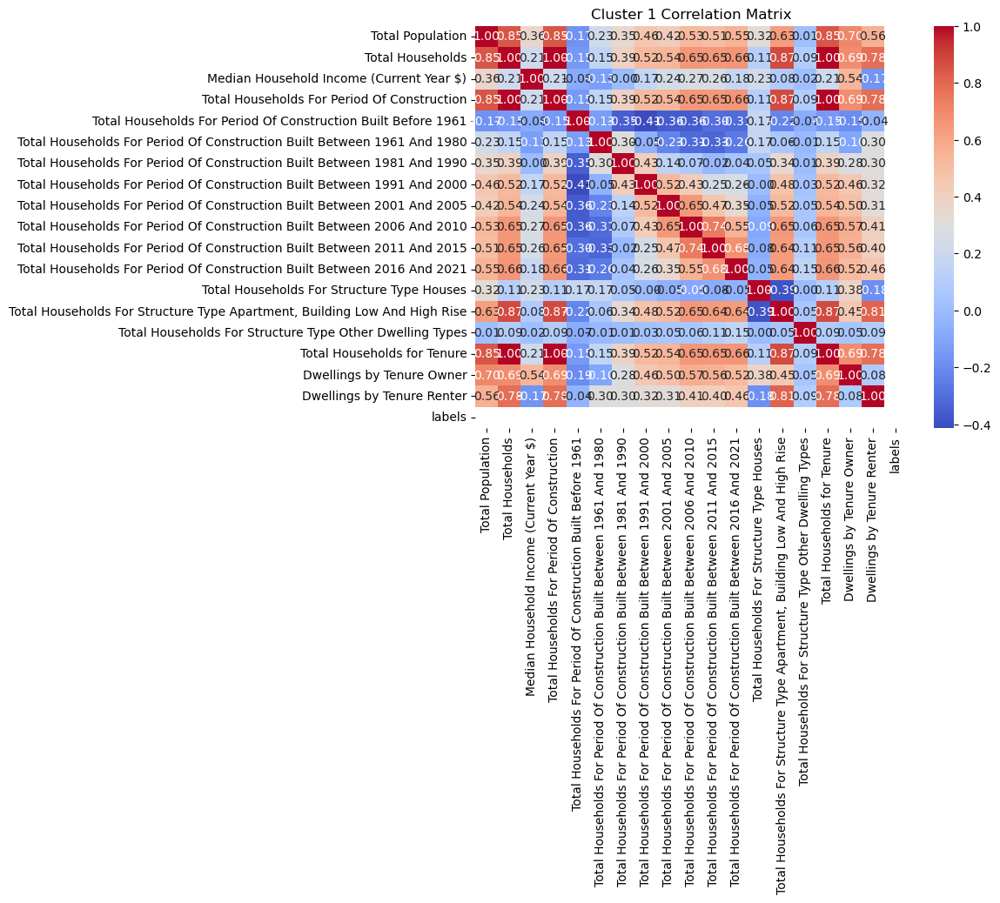

In [93]:
cluster1_corrM = cluster1_scaled.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(cluster1_corrM, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Cluster 1 Correlation Matrix')
plt.show()

In [94]:
cluster1_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.19747,0.066205,0.859375,0.066205,0.617188,0.071203,0.032154,0.040486,0.072193,0.013333,0.019400,0.011111,0.101796,0.099639,0.000000,0.066205,0.256637,0.061715,0.0
1,0.14174,0.079292,0.475000,0.079292,0.257812,0.246835,0.064309,0.064777,0.045455,0.026667,0.017637,0.064815,0.115768,0.103249,0.013158,0.079292,0.190898,0.132845,0.0


In [95]:
# # Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
# X_1 = cluster1_scaled.drop(columns=["Median Household Income (Current Year $)",
#                              "Total Population",
#                              "Total Households For Period Of Construction",
#                              "Total Households For Period Of Construction Built Between 1991 And 2000",
#                              "Total Households For Period Of Construction Built Between 2001 And 2005",
#                              "Total Households For Period Of Construction Built Between 2006 And 2010",
#                              "Total Households For Period Of Construction Built Between 2011 And 2015",
#                              "Total Households For Structure Type Houses",
#                              "Total Households For Structure Type Other Dwelling Types",
#                              "Total Households for Tenure",
#                              "Dwellings by Tenure Owner"])
# y_1 = cluster1_scaled["Median Household Income (Current Year $)"]

# X_1.head(2)

In [96]:
X_1 = cluster1_scaled.drop(columns=["Median Household Income (Current Year $)"])
y_1 = cluster1_scaled["Median Household Income (Current Year $)"]
X_1.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.19747,0.066205,0.066205,0.617188,0.071203,0.032154,0.040486,0.072193,0.013333,0.019400,0.011111,0.101796,0.099639,0.000000,0.066205,0.256637,0.061715,0.0
1,0.14174,0.079292,0.079292,0.257812,0.246835,0.064309,0.064777,0.045455,0.026667,0.017637,0.064815,0.115768,0.103249,0.013158,0.079292,0.190898,0.132845,0.0


In [97]:
X_1_train, X_1_test, y_1_train, y_1_test = train_test_split(X_1, y_1, test_size=0.2, random_state=42, shuffle=True)

#### Cluster 1 - Ridge Regression

In [98]:
ridge_1 = Ridge(random_state=42)
ridge_1_grid = {"alpha": range(0, 100, 1)}

In [99]:
ridge_1_random_search = RandomizedSearchCV(ridge_1, ridge_1_grid, return_train_score=True, random_state=42, n_jobs=-1)
ridge_1_random_search.fit(X_1_train, y_1_train)
best_ridge_1 = ridge_1_random_search.best_estimator_

print("Ridge Regression best prediction on training set")
print("Best Model: ", best_ridge_1)
print("Best Score: ", ridge_1_random_search.best_score_)
print("MSE: ", mean_squared_error(y_1_train, best_ridge_1.predict(X_1_train)))

Ridge Regression best prediction on training set
Best Model:  Ridge(alpha=0, random_state=42)
Best Score:  0.34140038558583047
MSE:  0.018306499911019857


In [100]:
test_pred_ridge_1 = best_ridge_1.predict(X_1_test)

print("Ridge Regression best prediction on testing set")
print("Best Score: ", best_ridge_1.score(X_1_test, y_1_test))
print("MSE: ", mean_squared_error(y_1_test, test_pred_ridge_1))

Ridge Regression best prediction on testing set
Best Score:  0.401186982251148
MSE:  0.01977246132893121


#### Cluster 1 - SVR

In [101]:
svr_1 = SVR()
svr_1_grid = {"kernel": ["linear", "poly", "rbf", "sigmoid", "precomputed"],
              "degree": range(0, 100, 1),
              "gamma": ["scale", "auto"],
              "C": range(0, 100, 1),
              "epsilon": np.arange(0,20, 0.1)}

In [102]:
svr_1_random_search = RandomizedSearchCV(svr_1, svr_1_grid, return_train_score=True, random_state=42, n_jobs=-1)
svr_1_random_search.fit(rbf_kernel(X_1_train.values), y_1_train)
best_svr_1 = svr_1_random_search.best_estimator_

print("SVR Regression best prediction on training set")
print("Best Model: ", best_svr_1)
print("Best Score: ", svr_1_random_search.best_score_)
print("MSE: ", mean_squared_error(y_1_train, best_svr_1.predict(rbf_kernel(X_1_train.values))))

SVR Regression best prediction on training set
Best Model:  SVR(C=80, degree=47, epsilon=4.7, gamma='auto', kernel='sigmoid')
Best Score:  -0.04293755964149315
MSE:  0.030976781952247186


#### Cluster 1 - Random Forest Regression¶

In [103]:
rf_1 = RandomForestRegressor(random_state=42)
rf_1_grid = {"n_estimators": range(1, 500, 1),
              "max_depth": range(1, 100, 1),
              "min_samples_split": range(2, 100, 1)}

In [104]:
rf_1_random_search = RandomizedSearchCV(rf_1, rf_1_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_1_random_search.fit(X_1_train, y_1_train)
best_rf_1 = rf_1_random_search.best_estimator_

print("Random Forest Regression best prediction on training set")
print("Best Model: ", best_rf_1)
print("Best Score: ", rf_1_random_search.best_score_)
print("MSE: ", mean_squared_error(y_1_train, best_rf_1.predict(X_1_train)))

Random Forest Regression best prediction on training set
Best Model:  RandomForestRegressor(max_depth=89, min_samples_split=4, n_estimators=199,
                      random_state=42)
Best Score:  0.44338622930773486
MSE:  0.002585090564113146


In [105]:
test_pred_rf_1 = best_rf_1.predict(X_1_test)

print("Random Forest Regression best prediction on testing set")
print("Best Score: ", best_rf_1.score(X_1_test, y_1_test))
print("MSE: ", mean_squared_error(y_1_test, test_pred_rf_1))

Random Forest Regression best prediction on testing set
Best Score:  0.4944976828408447
MSE:  0.016691395680223056


#### Cluster 1 - ANN

In [106]:
ann_1 = KerasRegressor(build_fn=build_model, verbose=2)
ann_1_grid = {"batch_size": range(1, 500, 10),
              "epochs": range(1, 100, 10)}

In [107]:
ann_1_random_search = RandomizedSearchCV(ann_1, ann_1_grid, cv=3, n_iter=5, verbose=2, n_jobs=-1, random_state=42)
ann_1_result = ann_1_random_search.fit(X_1_train, y_1_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Epoch 1/61


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



8/8 - 1s - loss: 0.0849 - accuracy: 0.0014 - mae: 0.2406 - mse: 0.0849 - 868ms/epoch - 109ms/step
Epoch 2/61
8/8 - 0s - loss: 0.0352 - accuracy: 0.0028 - mae: 0.1494 - mse: 0.0352 - 19ms/epoch - 2ms/step
Epoch 3/61
8/8 - 0s - loss: 0.0290 - accuracy: 0.0028 - mae: 0.1357 - mse: 0.0290 - 19ms/epoch - 2ms/step
Epoch 4/61
8/8 - 0s - loss: 0.0250 - accuracy: 0.0028 - mae: 0.1255 - mse: 0.0250 - 18ms/epoch - 2ms/step
Epoch 5/61
8/8 - 0s - loss: 0.0252 - accuracy: 0.0028 - mae: 0.1252 - mse: 0.0252 - 18ms/epoch - 2ms/step
Epoch 6/61
8/8 - 0s - loss: 0.0212 - accuracy: 0.0028 - mae: 0.1152 - mse: 0.0212 - 19ms/epoch - 2ms/step
Epoch 7/61
8/8 - 0s - loss: 0.0204 - accuracy: 0.0028 - mae: 0.1137 - mse: 0.0204 - 22ms/epoch - 3ms/step
Epoch 8/61
8/8 - 0s - loss: 0.0225 - accuracy: 0.0028 - mae: 0.1186 - mse: 0.0225 - 20ms/epoch - 3ms/step
Epoch 9/61
8/8 - 0s - loss: 0.0195 - accuracy: 0.0028 - mae: 0.1108 - mse: 0.0195 - 17ms/epoch - 2ms/step
Epoch 10/61
8/8 - 0s - loss: 0.0200 - accuracy: 0.0028

In [108]:
print("ANN Regression best prediction on training set")
print("Best Parameter: ", ann_1_result.best_params_)
print("Best Score: ", ann_1_result.best_score_)

ANN Regression best prediction on training set
Best Parameter:  {'epochs': 61, 'batch_size': 101}
Best Score:  0.45200661648975116


In [109]:
np.random.seed(42)
tf.random.set_seed(42)

ann_1_test_result = ann_1.fit(X_1_test, y_1_test, epochs=61, batch_size=101)

Epoch 1/61


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



2/2 - 1s - loss: 0.1251 - accuracy: 0.0000e+00 - mae: 0.3104 - mse: 0.1251 - 787ms/epoch - 393ms/step
Epoch 2/61
2/2 - 0s - loss: 0.0616 - accuracy: 0.0000e+00 - mae: 0.1983 - mse: 0.0616 - 7ms/epoch - 4ms/step
Epoch 3/61
2/2 - 0s - loss: 0.0478 - accuracy: 0.0000e+00 - mae: 0.1702 - mse: 0.0478 - 7ms/epoch - 3ms/step
Epoch 4/61
2/2 - 0s - loss: 0.0432 - accuracy: 0.0000e+00 - mae: 0.1591 - mse: 0.0432 - 9ms/epoch - 5ms/step
Epoch 5/61
2/2 - 0s - loss: 0.0396 - accuracy: 0.0000e+00 - mae: 0.1523 - mse: 0.0396 - 9ms/epoch - 5ms/step
Epoch 6/61
2/2 - 0s - loss: 0.0370 - accuracy: 0.0000e+00 - mae: 0.1475 - mse: 0.0370 - 9ms/epoch - 5ms/step
Epoch 7/61
2/2 - 0s - loss: 0.0352 - accuracy: 0.0000e+00 - mae: 0.1446 - mse: 0.0352 - 9ms/epoch - 4ms/step
Epoch 8/61
2/2 - 0s - loss: 0.0326 - accuracy: 0.0000e+00 - mae: 0.1384 - mse: 0.0326 - 7ms/epoch - 3ms/step
Epoch 9/61
2/2 - 0s - loss: 0.0312 - accuracy: 0.0000e+00 - mae: 0.1354 - mse: 0.0312 - 11ms/epoch - 5ms/step
Epoch 10/61
2/2 - 0s - lo

### Try regressions on cluster 2

In [110]:
scaler5 = MinMaxScaler()

cluster2_scaled = pd.DataFrame(scaler5.fit_transform(cluster2))
cluster2_scaled.columns = cluster2.columns
cluster2_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.328844,0.377104,0.286026,0.377104,0.479087,0.218519,0.044643,0.124113,0.017241,0.000000,0.000000,0.018248,0.261905,0.302583,0.000000,0.377104,0.143460,0.481793,0.0
1,0.463417,0.420875,0.825328,0.420875,0.258555,0.481481,0.089286,0.063830,0.017241,0.023346,0.034091,0.051095,0.574830,0.175277,0.018634,0.420875,0.415612,0.196078,0.0


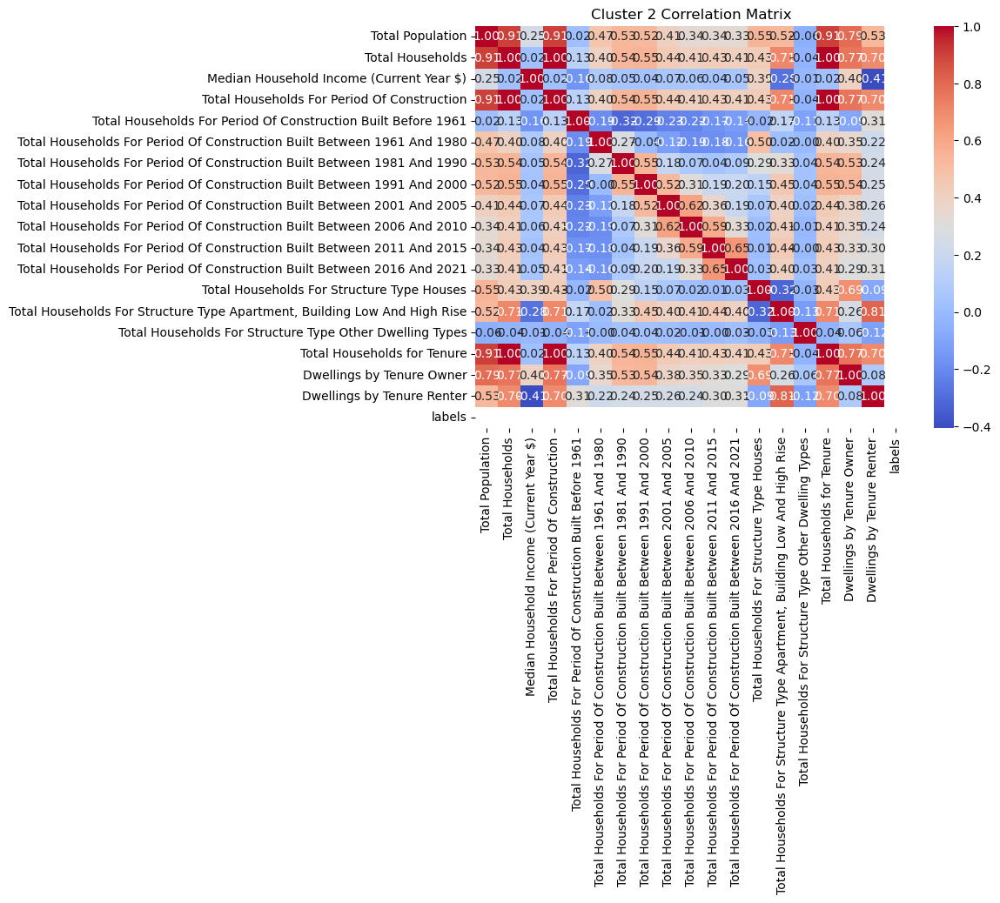

In [111]:
cluster2_corrM = cluster2_scaled.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(cluster2_corrM, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Cluster 2 Correlation Matrix')
plt.show()

In [112]:
cluster2_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.328844,0.377104,0.286026,0.377104,0.479087,0.218519,0.044643,0.124113,0.017241,0.000000,0.000000,0.018248,0.261905,0.302583,0.000000,0.377104,0.143460,0.481793,0.0
1,0.463417,0.420875,0.825328,0.420875,0.258555,0.481481,0.089286,0.063830,0.017241,0.023346,0.034091,0.051095,0.574830,0.175277,0.018634,0.420875,0.415612,0.196078,0.0


In [113]:
# # Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
# X_2 = cluster2_scaled.drop(columns=["Median Household Income (Current Year $)",
#                              "Total Population",
#                              "Total Households For Period Of Construction",
#                              "Total Households For Period Of Construction Built Between 1991 And 2000",
#                              "Total Households For Period Of Construction Built Between 2001 And 2005",
#                              "Total Households For Period Of Construction Built Between 2006 And 2010",
#                              "Total Households For Period Of Construction Built Between 2011 And 2015",
#                              "Total Households For Structure Type Houses",
#                              "Total Households For Structure Type Other Dwelling Types",
#                              "Total Households for Tenure",
#                              "Dwellings by Tenure Owner"])
# y_2 = cluster2_scaled["Median Household Income (Current Year $)"]

# X_2.head(2)

In [114]:
X_2 = cluster2_scaled.drop(columns=["Median Household Income (Current Year $)"])
y_2 = cluster2_scaled["Median Household Income (Current Year $)"]
X_2.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.328844,0.377104,0.377104,0.479087,0.218519,0.044643,0.124113,0.017241,0.000000,0.000000,0.018248,0.261905,0.302583,0.000000,0.377104,0.143460,0.481793,0.0
1,0.463417,0.420875,0.420875,0.258555,0.481481,0.089286,0.063830,0.017241,0.023346,0.034091,0.051095,0.574830,0.175277,0.018634,0.420875,0.415612,0.196078,0.0


In [115]:
X_2_train, X_2_test, y_2_train, y_2_test = train_test_split(X_2, y_2, test_size=0.2, random_state=42, shuffle=True)

#### Cluster 2 - Ridge Regression

In [116]:
ridge_2 = Ridge(random_state=42)
ridge_2_grid = {"alpha": range(0, 100, 1)}

In [117]:
ridge_2_random_search = RandomizedSearchCV(ridge_2, ridge_2_grid, return_train_score=True, random_state=42, n_jobs=-1)
ridge_2_random_search.fit(X_2_train, y_2_train)
best_ridge_2 = ridge_2_random_search.best_estimator_

print("Ridge Regression best prediction on training set")
print("Best Model: ", best_ridge_2)
print("Best Score: ", ridge_2_random_search.best_score_)
print("MSE: ", mean_squared_error(y_2_train, best_ridge_2.predict(X_2_train)))

Ridge Regression best prediction on training set
Best Model:  Ridge(alpha=0, random_state=42)
Best Score:  0.5199914084653432
MSE:  0.010843931259905518


In [118]:
test_pred_ridge_2 = best_ridge_2.predict(X_2_test)

print("Ridge Regression best prediction on testing set")
print("Best Score: ", best_ridge_2.score(X_2_test, y_2_test))
print("MSE: ", mean_squared_error(y_2_test, test_pred_ridge_2))

Ridge Regression best prediction on testing set
Best Score:  0.4605105314772032
MSE:  0.010918974742907721


#### Cluster 2 - SVR

In [119]:
svr_2 = SVR()
svr_2_grid = {"kernel": ["linear", "poly", "rbf", "sigmoid", "precomputed"],
              "degree": range(0, 100, 1),
              "gamma": ["scale", "auto"],
              "C": range(0, 100, 1),
              "epsilon": np.arange(0,20, 0.1)}

In [120]:
svr_2_random_search = RandomizedSearchCV(svr_2, svr_2_grid, return_train_score=True, random_state=42, n_jobs=-1)
svr_2_random_search.fit(rbf_kernel(X_2_train.values), y_2_train)
best_svr_2 = svr_2_random_search.best_estimator_

print("SVR Regression best prediction on training set")
print("Best Model: ", best_svr_2)
print("Best Score: ", svr_2_random_search.best_score_)
print("MSE: ", mean_squared_error(y_2_train, best_svr_2.predict(rbf_kernel(X_2_train.values))))

SVR Regression best prediction on training set
Best Model:  SVR(C=80, degree=47, epsilon=4.7, gamma='auto', kernel='sigmoid')
Best Score:  -0.0375599239412324
MSE:  0.023935230078695698


#### Cluster 2 - Random Forest Regression¶

In [121]:
rf_2 = RandomForestRegressor(random_state=42)
rf_2_grid = {"n_estimators": range(1, 500, 1),
              "max_depth": range(1, 100, 1),
              "min_samples_split": range(2, 100, 1)}

In [122]:
rf_2_random_search = RandomizedSearchCV(rf_2, rf_2_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_2_random_search.fit(X_2_train, y_2_train)
best_rf_2 = rf_2_random_search.best_estimator_

print("Random Forest Regression best prediction on training set")
print("Best Model: ", best_rf_2)
print("Best Score: ", rf_2_random_search.best_score_)
print("MSE: ", mean_squared_error(y_2_train, best_rf_2.predict(X_2_train)))

Random Forest Regression best prediction on training set
Best Model:  RandomForestRegressor(max_depth=89, min_samples_split=4, n_estimators=199,
                      random_state=42)
Best Score:  0.5622931828978258
MSE:  0.0015761949342642844


In [123]:
test_pred_rf_2 = best_rf_2.predict(X_2_test)

print("Random Forest Regression best prediction on testing set")
print("Best Score: ", best_rf_2.score(X_2_test, y_2_test))
print("MSE: ", mean_squared_error(y_2_test, test_pred_rf_2))

Random Forest Regression best prediction on testing set
Best Score:  0.539940631457428
MSE:  0.00931135252576696


#### Cluster 2 - ANN

In [124]:
ann_2 = KerasRegressor(build_fn=build_model, verbose=2)
ann_2_grid = {"batch_size": range(1, 500, 10),
              "epochs": range(1, 100, 10)}

In [125]:
ann_2_random_search = RandomizedSearchCV(ann_2, ann_2_grid, cv=3, n_iter=5, verbose=2, n_jobs=-1, random_state=42)
ann_2_result = ann_2_random_search.fit(X_2_train, y_2_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Epoch 1/81


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



4/4 - 1s - loss: 0.1794 - accuracy: 7.9554e-04 - mae: 0.3757 - mse: 0.1794 - 843ms/epoch - 211ms/step
Epoch 2/81
4/4 - 0s - loss: 0.0616 - accuracy: 7.9554e-04 - mae: 0.1982 - mse: 0.0616 - 13ms/epoch - 3ms/step
Epoch 3/81
4/4 - 0s - loss: 0.0435 - accuracy: 7.9554e-04 - mae: 0.1646 - mse: 0.0435 - 13ms/epoch - 3ms/step
Epoch 4/81
4/4 - 0s - loss: 0.0394 - accuracy: 7.9554e-04 - mae: 0.1570 - mse: 0.0394 - 11ms/epoch - 3ms/step
Epoch 5/81
4/4 - 0s - loss: 0.0359 - accuracy: 7.9554e-04 - mae: 0.1490 - mse: 0.0359 - 16ms/epoch - 4ms/step
Epoch 6/81
4/4 - 0s - loss: 0.0319 - accuracy: 7.9554e-04 - mae: 0.1394 - mse: 0.0319 - 15ms/epoch - 4ms/step
Epoch 7/81
4/4 - 0s - loss: 0.0291 - accuracy: 7.9554e-04 - mae: 0.1327 - mse: 0.0291 - 15ms/epoch - 4ms/step
Epoch 8/81
4/4 - 0s - loss: 0.0262 - accuracy: 7.9554e-04 - mae: 0.1248 - mse: 0.0262 - 15ms/epoch - 4ms/step
Epoch 9/81
4/4 - 0s - loss: 0.0242 - accuracy: 7.9554e-04 - mae: 0.1200 - mse: 0.0242 - 15ms/epoch - 4ms/step
Epoch 10/81
4/4 - 

Epoch 75/81
4/4 - 0s - loss: 0.0125 - accuracy: 7.9554e-04 - mae: 0.0884 - mse: 0.0125 - 13ms/epoch - 3ms/step
Epoch 76/81
4/4 - 0s - loss: 0.0093 - accuracy: 7.9554e-04 - mae: 0.0738 - mse: 0.0093 - 13ms/epoch - 3ms/step
Epoch 77/81
4/4 - 0s - loss: 0.0091 - accuracy: 7.9554e-04 - mae: 0.0733 - mse: 0.0091 - 13ms/epoch - 3ms/step
Epoch 78/81
4/4 - 0s - loss: 0.0102 - accuracy: 7.9554e-04 - mae: 0.0782 - mse: 0.0102 - 16ms/epoch - 4ms/step
Epoch 79/81
4/4 - 0s - loss: 0.0121 - accuracy: 7.9554e-04 - mae: 0.0879 - mse: 0.0121 - 14ms/epoch - 3ms/step
Epoch 80/81
4/4 - 0s - loss: 0.0096 - accuracy: 7.9554e-04 - mae: 0.0754 - mse: 0.0096 - 14ms/epoch - 3ms/step
Epoch 81/81
4/4 - 0s - loss: 0.0093 - accuracy: 7.9554e-04 - mae: 0.0749 - mse: 0.0093 - 12ms/epoch - 3ms/step


In [126]:
print("ANN Regression best prediction on training set")
print("Best Parameter: ", ann_2_result.best_params_)
print("Best Score: ", ann_2_result.best_score_)

ANN Regression best prediction on training set
Best Parameter:  {'epochs': 81, 'batch_size': 341}
Best Score:  0.5532994724672499


In [127]:
np.random.seed(42)
tf.random.set_seed(42)

ann_2_test_result = ann_2.fit(X_2_test, y_2_test, epochs=81, batch_size=341)

Epoch 1/81


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



1/1 - 1s - loss: 0.2890 - accuracy: 0.0000e+00 - mae: 0.5163 - mse: 0.2890 - 875ms/epoch - 875ms/step
Epoch 2/81
1/1 - 0s - loss: 0.1642 - accuracy: 0.0000e+00 - mae: 0.3761 - mse: 0.1642 - 7ms/epoch - 7ms/step
Epoch 3/81
1/1 - 0s - loss: 0.1067 - accuracy: 0.0000e+00 - mae: 0.2877 - mse: 0.1067 - 6ms/epoch - 6ms/step
Epoch 4/81
1/1 - 0s - loss: 0.0744 - accuracy: 0.0000e+00 - mae: 0.2291 - mse: 0.0744 - 8ms/epoch - 8ms/step
Epoch 5/81
1/1 - 0s - loss: 0.0561 - accuracy: 0.0000e+00 - mae: 0.1923 - mse: 0.0561 - 8ms/epoch - 8ms/step
Epoch 6/81
1/1 - 0s - loss: 0.0460 - accuracy: 0.0000e+00 - mae: 0.1738 - mse: 0.0460 - 8ms/epoch - 8ms/step
Epoch 7/81
1/1 - 0s - loss: 0.0408 - accuracy: 0.0000e+00 - mae: 0.1631 - mse: 0.0408 - 6ms/epoch - 6ms/step
Epoch 8/81
1/1 - 0s - loss: 0.0382 - accuracy: 0.0032 - mae: 0.1573 - mse: 0.0382 - 6ms/epoch - 6ms/step
Epoch 9/81
1/1 - 0s - loss: 0.0365 - accuracy: 0.0032 - mae: 0.1541 - mse: 0.0365 - 8ms/epoch - 8ms/step
Epoch 10/81
1/1 - 0s - loss: 0.035

Epoch 77/81
1/1 - 0s - loss: 0.0119 - accuracy: 0.0000e+00 - mae: 0.0816 - mse: 0.0119 - 6ms/epoch - 6ms/step
Epoch 78/81
1/1 - 0s - loss: 0.0118 - accuracy: 0.0032 - mae: 0.0881 - mse: 0.0118 - 7ms/epoch - 7ms/step
Epoch 79/81
1/1 - 0s - loss: 0.0118 - accuracy: 0.0000e+00 - mae: 0.0814 - mse: 0.0118 - 8ms/epoch - 8ms/step
Epoch 80/81
1/1 - 0s - loss: 0.0118 - accuracy: 0.0032 - mae: 0.0886 - mse: 0.0118 - 5ms/epoch - 5ms/step
Epoch 81/81
1/1 - 0s - loss: 0.0120 - accuracy: 0.0000e+00 - mae: 0.0816 - mse: 0.0120 - 9ms/epoch - 9ms/step


### Try regressions on cluster 3

In [128]:
scaler6 = MinMaxScaler()

cluster3_scaled = pd.DataFrame(scaler6.fit_transform(cluster3))
cluster3_scaled.columns = cluster3.columns
cluster3_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.008837,0.012569,0.591633,0.012569,0.011682,0.509009,0.031746,0.008824,0.008403,0.006601,0.000000,0.000000,0.062937,0.046931,0.000000,0.012569,0.052780,0.066946,0.0
1,0.045604,0.097408,0.173307,0.097408,0.098131,0.495495,0.165079,0.050000,0.029412,0.029703,0.015789,0.002667,0.083139,0.099278,0.141141,0.097408,0.113101,0.158996,0.0


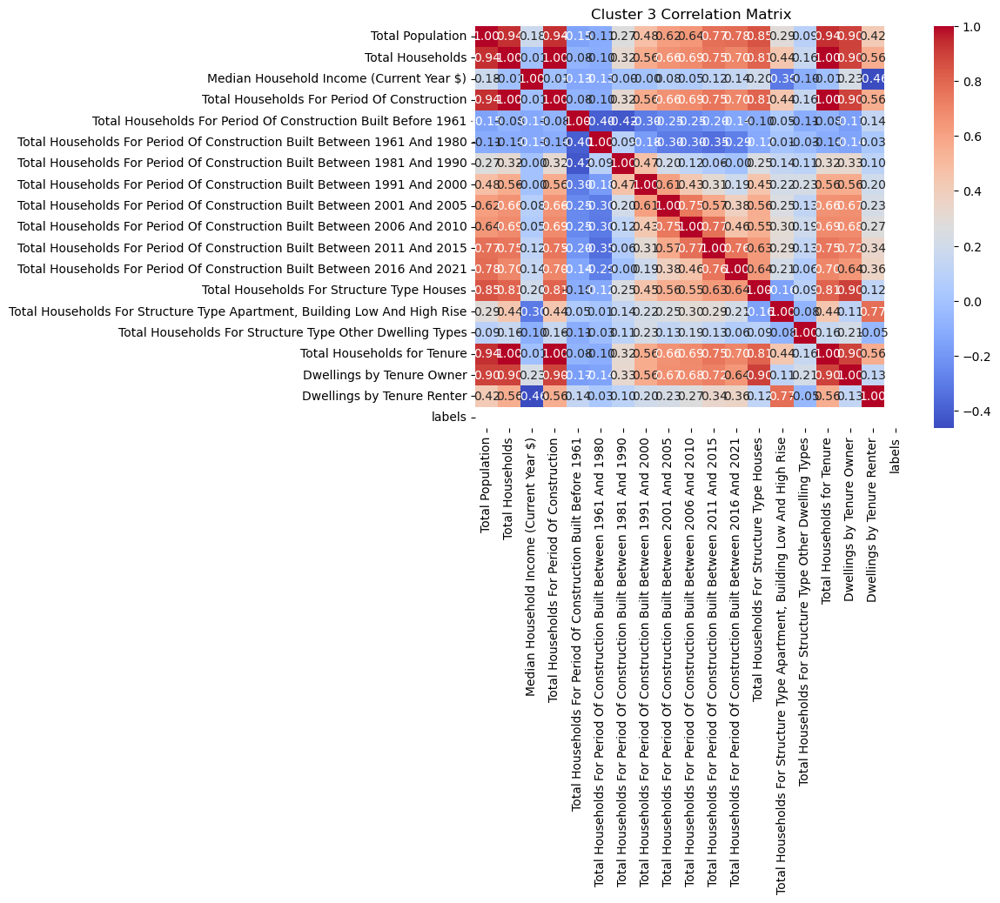

In [129]:
cluster3_corrM = cluster3_scaled.corr()

plt.figure(figsize=(8, 6))
sns.heatmap(cluster3_corrM, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Cluster 3 Correlation Matrix')
plt.show()

In [130]:
cluster3_scaled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.008837,0.012569,0.591633,0.012569,0.011682,0.509009,0.031746,0.008824,0.008403,0.006601,0.000000,0.000000,0.062937,0.046931,0.000000,0.012569,0.052780,0.066946,0.0
1,0.045604,0.097408,0.173307,0.097408,0.098131,0.495495,0.165079,0.050000,0.029412,0.029703,0.015789,0.002667,0.083139,0.099278,0.141141,0.097408,0.113101,0.158996,0.0


In [131]:
# # Drop target variable, variables that have very low correlation with income, and variables that have high correlation with other variables
# X_3 = cluster3_scaled.drop(columns=["Median Household Income (Current Year $)",
#                              "Total Population",
#                              "Total Households For Period Of Construction",
#                              "Total Households For Period Of Construction Built Between 1991 And 2000",
#                              "Total Households For Period Of Construction Built Between 2001 And 2005",
#                              "Total Households For Period Of Construction Built Between 2006 And 2010",
#                              "Total Households For Period Of Construction Built Between 2011 And 2015",
#                              "Total Households For Structure Type Houses",
#                              "Total Households For Structure Type Other Dwelling Types",
#                              "Total Households for Tenure",
#                              "Dwellings by Tenure Owner"])
# y_3 = cluster3_scaled["Median Household Income (Current Year $)"]

# X_3.head(2)

In [132]:
X_3 = cluster3_scaled.drop(columns=["Median Household Income (Current Year $)"])
y_3 = cluster3_scaled["Median Household Income (Current Year $)"]
X_3.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.008837,0.012569,0.012569,0.011682,0.509009,0.031746,0.008824,0.008403,0.006601,0.000000,0.000000,0.062937,0.046931,0.000000,0.012569,0.052780,0.066946,0.0
1,0.045604,0.097408,0.097408,0.098131,0.495495,0.165079,0.050000,0.029412,0.029703,0.015789,0.002667,0.083139,0.099278,0.141141,0.097408,0.113101,0.158996,0.0


In [133]:
X_3_train, X_3_test, y_3_train, y_3_test = train_test_split(X_3, y_3, test_size=0.2, random_state=42, shuffle=True)

#### Cluster 3 - Ridge Regression

In [134]:
ridge_3 = Ridge(random_state=42)
ridge_3_grid = {"alpha": range(0, 100, 1)}

In [135]:
ridge_3_random_search = RandomizedSearchCV(ridge_3, ridge_3_grid, return_train_score=True, random_state=42, n_jobs=-1)
ridge_3_random_search.fit(X_3_train, y_3_train)
best_ridge_3 = ridge_3_random_search.best_estimator_

print("Ridge Regression best prediction on training set")
print("Best Model: ", best_ridge_3)
print("Best Score: ", ridge_3_random_search.best_score_)
print("MSE: ", mean_squared_error(y_3_train, best_ridge_3.predict(X_3_train)))

Ridge Regression best prediction on training set
Best Model:  Ridge(alpha=0, random_state=42)
Best Score:  0.4833149270693508
MSE:  0.010276780812021396


In [136]:
test_pred_ridge_3 = best_ridge_3.predict(X_3_test)

print("Ridge Regression best prediction on testing set")
print("Best Score: ", best_ridge_3.score(X_3_test, y_3_test))
print("MSE: ", mean_squared_error(y_3_test, test_pred_ridge_3))

Ridge Regression best prediction on testing set
Best Score:  0.319344918478197
MSE:  0.015067553224335542


#### Cluster 3 - SVR

In [137]:
svr_3 = SVR()
svr_3_grid = {"kernel": ["linear", "poly", "rbf", "sigmoid", "precomputed"],
              "degree": range(0, 100, 1),
              "gamma": ["scale", "auto"],
              "C": range(0, 100, 1),
              "epsilon": np.arange(0,20, 0.1)}

In [138]:
svr_3_random_search = RandomizedSearchCV(svr_3, svr_3_grid, return_train_score=True, random_state=42, n_jobs=-1)
svr_3_random_search.fit(rbf_kernel(X_3_train.values), y_3_train)
best_svr_3 = svr_3_random_search.best_estimator_

print("SVR Regression best prediction on training set")
print("Best Model: ", best_svr_3)
print("Best Score: ", svr_3_random_search.best_score_)
print("MSE: ", mean_squared_error(y_3_train, best_svr_3.predict(rbf_kernel(X_3_train.values))))

SVR Regression best prediction on training set
Best Model:  SVR(C=72, degree=93, epsilon=1.8, gamma='auto', kernel='poly')
Best Score:  -1.0422269557466095
MSE:  0.04443240297602376


#### Cluster 3 - Random Forest Regression¶

In [139]:
rf_3 = RandomForestRegressor(random_state=42)
rf_3_grid = {"n_estimators": range(1, 500, 1),
              "max_depth": range(1, 100, 1),
              "min_samples_split": range(2, 100, 1)}

In [140]:
rf_3_random_search = RandomizedSearchCV(rf_3, rf_3_grid, return_train_score=True, random_state=42, n_jobs=-1)
rf_3_random_search.fit(X_3_train, y_3_train)
best_rf_3 = rf_3_random_search.best_estimator_

print("Random Forest Regression best prediction on training set")
print("Best Model: ", best_rf_3)
print("Best Score: ", rf_3_random_search.best_score_)
print("MSE: ", mean_squared_error(y_3_train, best_rf_3.predict(X_3_train)))

Random Forest Regression best prediction on training set
Best Model:  RandomForestRegressor(max_depth=89, min_samples_split=4, n_estimators=199,
                      random_state=42)
Best Score:  0.4823719738845512
MSE:  0.0017591945557423837


In [141]:
test_pred_rf_3 = best_rf_3.predict(X_3_test)

print("Random Forest Regression best prediction on testing set")
print("Best Score: ", best_rf_3.score(X_3_test, y_3_test))
print("MSE: ", mean_squared_error(y_3_test, test_pred_rf_3))

Random Forest Regression best prediction on testing set
Best Score:  0.5344544805379157
MSE:  0.010305707080247807


#### Cluster 3 - ANN

In [142]:
ann_3 = KerasRegressor(build_fn=build_model, verbose=2)
ann_3_grid = {"batch_size": range(1, 500, 10),
              "epochs": range(1, 100, 10)}

In [143]:
ann_3_random_search = RandomizedSearchCV(ann_3, ann_3_grid, cv=3, n_iter=5, verbose=2, n_jobs=-1, random_state=42)
ann_3_result = ann_3_random_search.fit(X_3_train, y_3_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
Epoch 1/61


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



10/10 - 1s - loss: 0.0380 - accuracy: 0.0011 - mae: 0.1537 - mse: 0.0380 - 783ms/epoch - 78ms/step
Epoch 2/61
10/10 - 0s - loss: 0.0240 - accuracy: 0.0011 - mae: 0.1214 - mse: 0.0240 - 23ms/epoch - 2ms/step
Epoch 3/61
10/10 - 0s - loss: 0.0204 - accuracy: 0.0011 - mae: 0.1114 - mse: 0.0204 - 23ms/epoch - 2ms/step
Epoch 4/61
10/10 - 0s - loss: 0.0181 - accuracy: 0.0011 - mae: 0.1041 - mse: 0.0181 - 20ms/epoch - 2ms/step
Epoch 5/61
10/10 - 0s - loss: 0.0167 - accuracy: 0.0011 - mae: 0.0998 - mse: 0.0167 - 19ms/epoch - 2ms/step
Epoch 6/61
10/10 - 0s - loss: 0.0161 - accuracy: 0.0011 - mae: 0.0974 - mse: 0.0161 - 22ms/epoch - 2ms/step
Epoch 7/61
10/10 - 0s - loss: 0.0143 - accuracy: 0.0011 - mae: 0.0922 - mse: 0.0143 - 24ms/epoch - 2ms/step
Epoch 8/61
10/10 - 0s - loss: 0.0138 - accuracy: 0.0022 - mae: 0.0902 - mse: 0.0138 - 21ms/epoch - 2ms/step
Epoch 9/61
10/10 - 0s - loss: 0.0135 - accuracy: 0.0011 - mae: 0.0898 - mse: 0.0135 - 21ms/epoch - 2ms/step
Epoch 10/61
10/10 - 0s - loss: 0.0127

In [144]:
print("ANN Regression best prediction on training set")
print("Best Parameter: ", ann_3_result.best_params_)
print("Best Score: ", ann_3_result.best_score_)

ANN Regression best prediction on training set
Best Parameter:  {'epochs': 61, 'batch_size': 101}
Best Score:  0.46278617150898144


In [145]:
np.random.seed(42)
tf.random.set_seed(42)

ann_3_test_result = ann_3.fit(X_3_test, y_3_test, epochs=61, batch_size=101)

Epoch 1/61


C:\Users\ganlu\Software\Anaconda\Install\Lib\site-packages\scikeras\wrappers.py:915: UserWarning:

``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.



3/3 - 1s - loss: 0.0888 - accuracy: 0.0000e+00 - mae: 0.2452 - mse: 0.0888 - 799ms/epoch - 266ms/step
Epoch 2/61
3/3 - 0s - loss: 0.0402 - accuracy: 0.0000e+00 - mae: 0.1614 - mse: 0.0402 - 10ms/epoch - 3ms/step
Epoch 3/61
3/3 - 0s - loss: 0.0354 - accuracy: 0.0000e+00 - mae: 0.1515 - mse: 0.0354 - 12ms/epoch - 4ms/step
Epoch 4/61
3/3 - 0s - loss: 0.0321 - accuracy: 0.0000e+00 - mae: 0.1427 - mse: 0.0321 - 11ms/epoch - 4ms/step
Epoch 5/61
3/3 - 0s - loss: 0.0293 - accuracy: 0.0000e+00 - mae: 0.1355 - mse: 0.0293 - 10ms/epoch - 3ms/step
Epoch 6/61
3/3 - 0s - loss: 0.0269 - accuracy: 0.0000e+00 - mae: 0.1315 - mse: 0.0269 - 9ms/epoch - 3ms/step
Epoch 7/61
3/3 - 0s - loss: 0.0247 - accuracy: 0.0000e+00 - mae: 0.1238 - mse: 0.0247 - 9ms/epoch - 3ms/step
Epoch 8/61
3/3 - 0s - loss: 0.0240 - accuracy: 0.0000e+00 - mae: 0.1214 - mse: 0.0240 - 11ms/epoch - 4ms/step
Epoch 9/61
3/3 - 0s - loss: 0.0214 - accuracy: 0.0000e+00 - mae: 0.1141 - mse: 0.0214 - 10ms/epoch - 3ms/step
Epoch 10/61
3/3 - 0s

### Training Conclusion:

For classification the dataset into 4 clusters, we found RandomForestClassifier had the best results.(accuracy on test set: 91.33%)

Best model: **best_rf_c {'n_estimators': 135, 'max_depth': 85}**

For predicting median income, we found the best way is to add in cluster information, and predict as a whole dataset.(accuracy on test set: 80.65%)

Best model: **best_rf_w {max_depth=89, min_samples_split=4, n_estimators=199, random_state=42}**

## Do the same preprocessing on the test dataset, predict cluster group, and predict median income.

In [146]:
test_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855 entries, 0 to 854
Data columns (total 17 columns):
 #   Column                                                                     Non-Null Count  Dtype
---  ------                                                                     --------------  -----
 0   Total Population                                                           855 non-null    int64
 1   Total Households                                                           855 non-null    int64
 2   Total Households For Period Of Construction                                855 non-null    int64
 3   Total Households For Period Of Construction Built Before 1961              855 non-null    int64
 4   Total Households For Period Of Construction Built Between 1961 And 1980    855 non-null    int64
 5   Total Households For Period Of Construction Built Between 1981 And 1990    855 non-null    int64
 6   Total Households For Period Of Construction Built Between 1991 And 2000   

In [147]:
test_selected = test_raw[["Total Households For Period Of Construction Built Before 1961",
                          "Total Households For Period Of Construction Built Between 1961 And 1980",
                          "Total Households For Structure Type Houses",
                          "Total Households For Structure Type Apartment, Building Low And High Rise",
                          "Dwellings by Tenure Owner",
                          "Dwellings by Tenure Renter"]]
test_selected.columns = ["households_built_before_1961", "households_built_between_1961_1980", "house_type", "apt_building_type",
                         "owner_dwelling", "renter_dwelling"]

test_selected = (test_selected.assign(households_built_before_1980 = test_selected["households_built_before_1961"] + test_selected["households_built_between_1961_1980"])
                  .drop(columns=["households_built_before_1961", "households_built_between_1961_1980"]))

test_selected.head()

,house_type,apt_building_type,owner_dwelling,renter_dwelling,households_built_before_1980
0,5,4195,765,3430,1355
1,105,3330,2140,1365,45
2,1380,1590,1630,1355,25
3,75,560,90,565,620
4,485,1125,645,970,1395


In [148]:
test_c_scaler = MinMaxScaler()
scaled_test_selected = pd.DataFrame(test_c_scaler.fit_transform(test_selected))
scaled_test_selected.columns = test_selected.columns
scaled_test_selected.head(2)

,house_type,apt_building_type,owner_dwelling,renter_dwelling,households_built_before_1980
0,0.000770,0.600143,0.123887,0.892068,0.501852
1,0.016179,0.476395,0.346559,0.355007,0.016667


In [149]:
predicted_clusters = best_rf_c.predict(scaled_test_selected)
predicted_clusters

array([1, 1, 1, 2, 1, 2, 3, 3, 1, 0, 3, 3, 3, 3, 1, 2, 0, 1, 2, 2, 1, 0,
       2, 1, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 3, 2, 1, 1, 0, 1, 1, 2, 0,
       1, 3, 2, 1, 3, 0, 1, 3, 2, 3, 3, 3, 0, 1, 1, 2, 1, 1, 1, 2, 2, 3,
       0, 1, 3, 1, 3, 0, 2, 3, 1, 0, 1, 2, 0, 1, 3, 2, 3, 1, 3, 2, 0, 1,
       2, 3, 1, 2, 1, 3, 1, 1, 3, 2, 3, 3, 0, 3, 3, 2, 0, 1, 2, 1, 0, 3,
       3, 1, 0, 0, 3, 0, 2, 3, 3, 1, 3, 0, 3, 2, 3, 3, 1, 1, 1, 1, 3, 2,
       1, 3, 2, 2, 2, 2, 0, 0, 3, 1, 1, 1, 1, 1, 1, 1, 2, 1, 3, 3, 1, 3,
       0, 3, 1, 2, 1, 3, 2, 3, 0, 0, 2, 0, 1, 1, 0, 1, 1, 3, 3, 2, 2, 1,
       2, 0, 3, 1, 1, 3, 3, 2, 2, 3, 1, 0, 1, 2, 1, 1, 0, 2, 3, 2, 3, 3,
       2, 2, 3, 2, 2, 0, 2, 3, 2, 2, 3, 2, 3, 3, 3, 1, 0, 0, 1, 3, 2, 1,
       0, 3, 3, 1, 2, 1, 2, 0, 2, 0, 1, 3, 0, 0, 0, 0, 1, 2, 1, 1, 3, 2,
       1, 3, 2, 2, 3, 0, 2, 0, 2, 2, 3, 1, 3, 0, 3, 2, 1, 3, 0, 0, 3, 3,
       0, 0, 3, 2, 2, 1, 3, 0, 2, 1, 1, 0, 2, 3, 3, 1, 2, 3, 1, 2, 3, 2,
       2, 1, 3, 2, 3, 3, 0, 2, 0, 3, 1, 3, 3, 1, 3,

In [150]:
test_full = test_raw.assign(labels=predicted_clusters)
test_full.head()

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,7333,4195,4195,125,1230,435,415,865,325,210,585,5,4195,0,4195,765,3430,1
1,6624,3510,3510,15,30,70,510,990,1010,820,65,105,3330,75,3510,2140,1365,1
2,7446,2985,2985,25,0,15,135,455,555,730,1070,1380,1590,15,2985,1630,1355,1
3,1049,655,655,435,185,20,0,0,0,0,10,75,560,20,655,90,565,2
4,4630,1610,1610,705,690,95,65,15,0,0,40,485,1125,0,1610,645,970,1


In [151]:
train_org_labeled.head(2)

,Total Population,Total Households,Median Household Income (Current Year $),Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,3088,1235.0,107000.0,1235.0,25.0,1130.0,50.0,15.0,10.0,10.0,0.0,0.0,1135,130,0,1235.0,1055.0,180.0,3
1,5889,1665.0,111000.0,1665.0,0.0,0.0,0.0,15.0,20.0,375.0,315.0,935.0,1605,50,10,1665.0,1365.0,300.0,0


In [152]:
test_r_scaler = MinMaxScaler()
test_r_income_scaler = MinMaxScaler()

train_org_labeled_NoIncome = train_org_labeled.drop(columns=["Median Household Income (Current Year $)"])

test_r_scaler.fit(train_org_labeled_NoIncome)
test_r_income_scaler.fit(train_org_labeled["Median Household Income (Current Year $)"].values.reshape(-1, 1))

MinMaxScaler()

In [153]:
test_full_scaled = pd.DataFrame(test_r_scaler.transform(test_full))
test_full_scaled.columns = test_full.columns
test_full_scaled.head(2)

,Total Population,Total Households,Total Households For Period Of Construction,Total Households For Period Of Construction Built Before 1961,Total Households For Period Of Construction Built Between 1961 And 1980,Total Households For Period Of Construction Built Between 1981 And 1990,Total Households For Period Of Construction Built Between 1991 And 2000,Total Households For Period Of Construction Built Between 2001 And 2005,Total Households For Period Of Construction Built Between 2006 And 2010,Total Households For Period Of Construction Built Between 2011 And 2015,Total Households For Period Of Construction Built Between 2016 And 2021,Total Households For Structure Type Houses,"Total Households For Structure Type Apartment, Building Low And High Rise",Total Households For Structure Type Other Dwelling Types,Total Households for Tenure,Dwellings by Tenure Owner,Dwellings by Tenure Renter,labels
0,0.240350,0.526248,0.526248,0.058411,0.389241,0.261261,0.167002,0.462567,0.144444,0.074074,0.104000,0.000698,0.535760,0.000000,0.526248,0.125822,0.648393,0.333333
1,0.216236,0.438540,0.438540,0.007009,0.009494,0.042042,0.205231,0.529412,0.448889,0.289242,0.011556,0.014655,0.425287,0.045045,0.438540,0.351974,0.258034,0.333333


In [154]:
predicted_income = best_rf_w.predict(test_full_scaled)
predicted_income

array([0.14807338, 0.22055801, 0.22566222, 0.11325058, 0.17359224,
       0.27470541, 0.30227451, 0.26709133, 0.19312936, 0.32036945,
       0.26781803, 0.2934949 , 0.24857246, 0.35190649, 0.1912074 ,
       0.2055833 , 0.35247617, 0.10840999, 0.22889425, 0.21432781,
       0.08327286, 0.32047564, 0.19834013, 0.24002538, 0.18642596,
       0.22223933, 0.18482856, 0.12466709, 0.32087673, 0.36481636,
       0.33325705, 0.44898536, 0.38777311, 0.33990888, 0.2053261 ,
       0.32101874, 0.10232718, 0.17376583, 0.1692665 , 0.31223892,
       0.15416776, 0.1358707 , 0.26209513, 0.3682531 , 0.18731307,
       0.23192851, 0.26440809, 0.18522779, 0.25388566, 0.34425878,
       0.24459717, 0.35671631, 0.21009766, 0.31854409, 0.27356485,
       0.27442015, 0.38264154, 0.17593132, 0.10524122, 0.22131029,
       0.19418368, 0.16253782, 0.15543639, 0.25885523, 0.2459084 ,
       0.29943514, 0.35741952, 0.16063216, 0.29490387, 0.18685115,
       0.31260968, 0.37048108, 0.25048016, 0.27204212, 0.18600

In [155]:
scaled_back_pred_income = test_r_income_scaler.inverse_transform([predicted_income])
scaled_back_pred_income

array([[ 55472.69420697,  71172.86551807,  72278.43762463,
         47930.07559442,  61000.07896626,  82901.19227088,
         88872.65892957,  81251.98312994,  65231.81861689,
         92792.02361011,  81409.38541916,  86970.99585228,
         77240.79524607,  99622.94669317,  64815.52365   ,
         67929.34374252,  99746.33883704,  46881.60405201,
         72978.49445641,  69823.40372497,  41436.90236899,
         92815.02353035,  66360.47240169,  75389.4966898 ,
         63779.86280609,  71537.03876525,  63433.86615618,
         50402.89223897,  92901.89937784, 102419.22309963,
         95583.47690835, 120650.23004634, 107391.65470208,
         97024.26417803,  67873.63324559,  92932.65932839,
         45564.06795884,  61037.67887054,  60063.12406187,
         91030.95074942,  56792.73789583,  52829.59300471,
         80169.80537609, 103163.62167983,  63972.01124671,
         73635.71548217,  80670.79325197,  63520.33859775,
         78391.63416288,  97966.45130414,  76379.7463508

In [156]:
pred_income_df = pd.DataFrame(scaled_back_pred_income[0], columns=["predicted_income"])
pred_income_df

,predicted_income
0,55472.694207
1,71172.865518
2,72278.437625
3,47930.075594
4,61000.078966
...,...
850,74470.299115
851,65210.597432
852,111411.019383
853,93147.936109


In [157]:
pred_income_df.to_csv("Team14predictions", index=False, header=False)